In [138]:

import plot_functions
import compare_clusterings
import process_data
import visualizations

from compare_clusterings import *
from process_data import *
from plot_functions import *
from visualizations import *

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import mpl_toolkits.mplot3d.axes3d as p3
import matplotlib.animation as animation

In [3]:
import traj_generator
import physics_sim_simple_moreparticles_proteins

import process_data

In [4]:
import numpy as np
import plotly.graph_objs as go

In [5]:
move_groups_nr = 3
particles_per_group = 100

explicit_groups = []
group_size = 10

curr_group = 0
while 1 == 1:
    for i in range(group_size):
        explicit_groups.append(curr_group%move_groups_nr)

        if len(explicit_groups) == particles_per_group:
            break
    if len(explicit_groups) == particles_per_group:
        break
    curr_group = curr_group + 1


In [6]:
explicit_groups

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

In [7]:
particles_from_sim = physics_sim_simple_moreparticles_proteins.simulate_for_clustering(stim_steps=1000, temp=[1,2,3], thermostat=1, entities=1, particles_per_group=100, group_thermostat=0, dt=0.01, harmpot=1, fenepot=0, desireddist = 1.04, pot_const=5, group_additions=True, friction=1, explicit_groups=explicit_groups)

In [8]:
trajectories = process_data.simulation_to_array(particles_from_sim)

In [9]:
plot_functions.plot_traj_labels_plotly_2nd(trajectories)

In [10]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [11]:
num_groups

3

In [12]:
%matplotlib notebook


a = plot_functions.plot_traj_labels_plt(trajectories, save_video=False, interval = 10)

<IPython.core.display.Javascript object>

In [13]:
a

In [14]:
plt.show()

In [15]:
from IPython.display import HTML
HTML(a.to_html5_video())

In [16]:
df = process_data.create_clustering_df(trajectories)

In [17]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0318


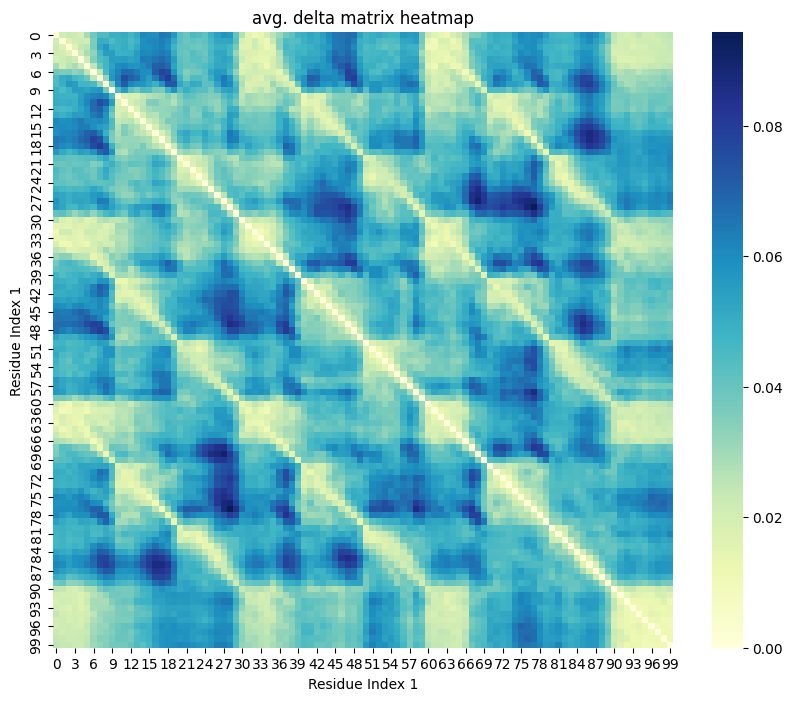

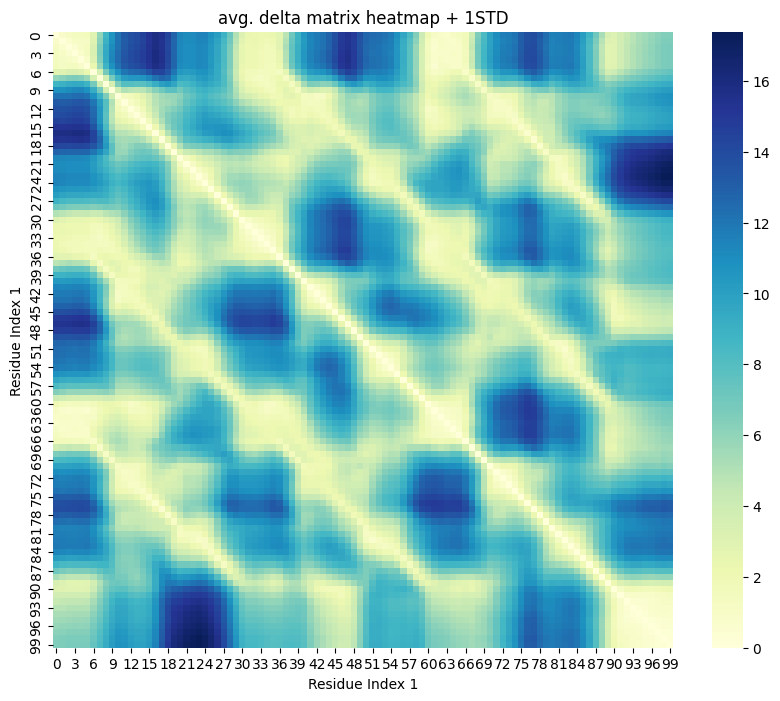

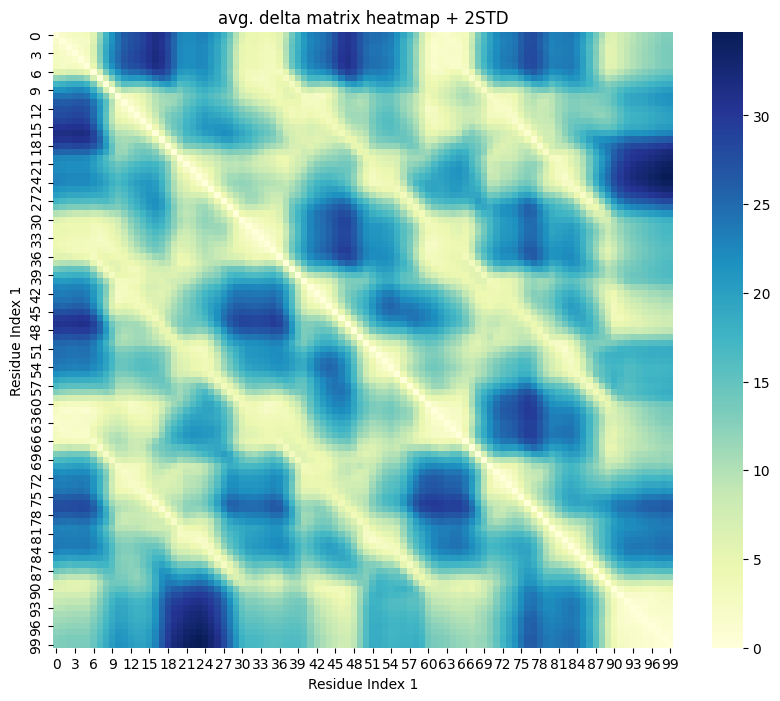

1.8185


In [18]:
%matplotlib inline

res_hdbscan_2std = redpandda_general.main_clustering_general_std(df, None, clustering_algorithm="hdbscan")

In [19]:
res_hdbscan_2std

(array([ 1,  1,  1,  1,  1,  1,  1, -1, -1, -1, -1, -1, -1, -1,  1,  1,  1,
         1,  2,  2,  2,  2,  2,  2,  2,  2,  2, -1, -1, -1, -1, -1, -1, -1,
         1,  1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,  1,  1,  1, -1, -1,
        -1, -1, -1, -1, -1, -1, -1, -1, -1,  0,  0,  0,  0,  0,  0, -1, -1,
        -1, -1, -1, -1, -1, -1, -1,  0,  0,  0, -1, -1, -1, -1, -1, -1, -1,
        -1, -1, -1, -1, -1, -1,  2,  2,  2,  2,  2,  2,  2,  2,  2]),
 32.908069304505446,
 array([[1.        , 0.95105963, 0.93460763, ..., 0.64597852, 0.62910334,
         0.62588957],
        [0.95105963, 1.        , 0.96264075, ..., 0.64106991, 0.62443114,
         0.62131467],
        [0.93460763, 0.96264075, 1.        , ..., 0.63562825, 0.62040314,
         0.61694375],
        ...,
        [0.64597852, 0.64106991, 0.63562825, ..., 1.        , 0.98052141,
         0.97832578],
        [0.62910334, 0.62443114, 0.62040314, ..., 0.98052141, 1.        ,
         0.98291354],
        [0.62588957, 0.62131467, 0.6

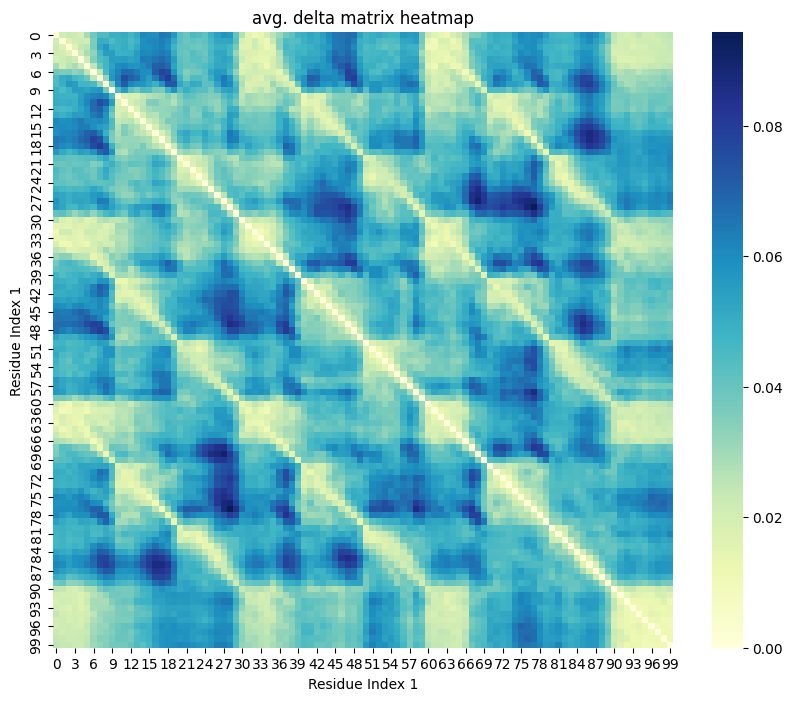

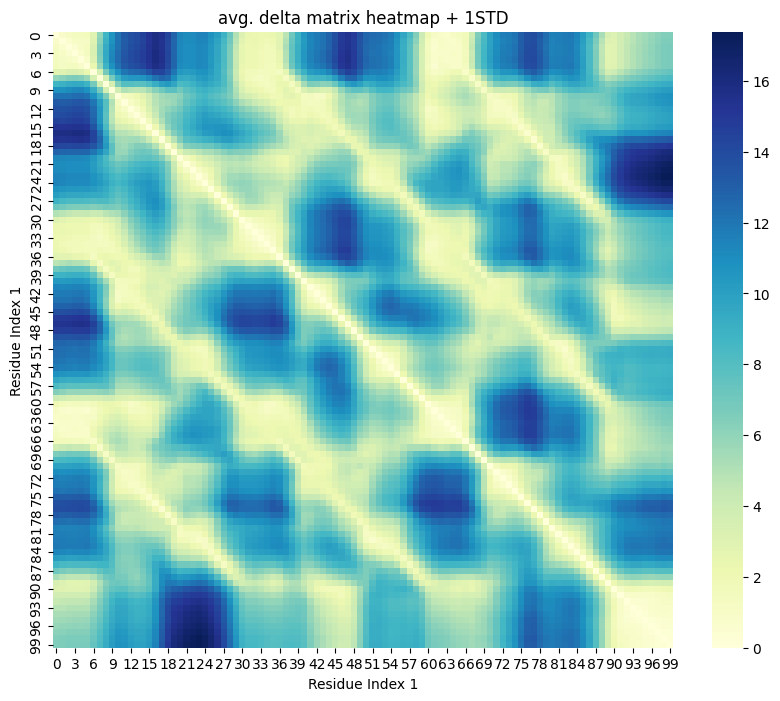

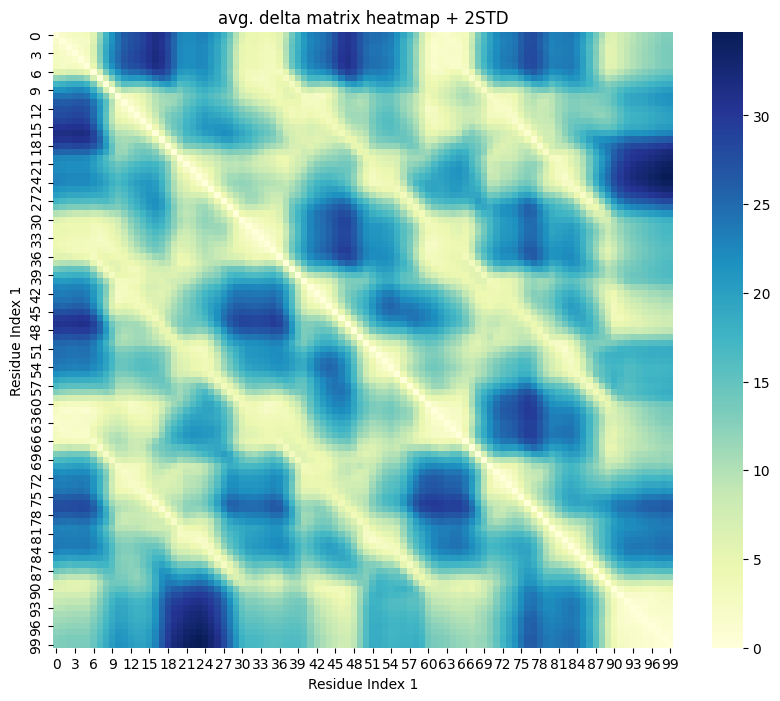

2.3876


In [20]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

In [21]:
import redpandda_general
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0068


In [22]:
res_hdbscan

(array([13, 13, 13, 13, 13, 13,  8,  4, 10,  1, 11, 11, 11, 11, 11, 11, 12,
         9,  5,  2,  6,  6,  6,  6,  6,  6,  6,  7,  3,  0, 13, 13, 13, 13,
        13, 13,  8,  4, 10,  1, 11, 11, 11, 11, 11, 11, 12,  9,  5,  2,  6,
         6,  6,  6,  6,  6,  6,  7,  3,  0, 13, 13, 13, 13, 13, 13,  8,  4,
        10,  1, 11, 11, 11, 11, 11, 11, 12,  9,  5,  2,  6,  6,  6,  6,  6,
         6,  6,  6,  3,  0, -1, 14, 14, 14, 14, 14, 14, 14, 14, 14]),
 5.079323351315091,
 array([[0.99847952, 0.99880647, 0.99884193, ..., 0.99885258, 0.99886661,
         0.99888479],
        [0.99880647, 0.99847952, 0.99874709, ..., 0.99881702, 0.99885806,
         0.99886112],
        [0.99884193, 0.99874709, 0.99847952, ..., 0.99883491, 0.9988306 ,
         0.99886432],
        ...,
        [0.99885258, 0.99881702, 0.99883491, ..., 0.99847952, 0.99866592,
         0.99865938],
        [0.99886661, 0.99885806, 0.9988306 , ..., 0.99866592, 0.99847952,
         0.99866574],
        [0.99888479, 0.99886112, 0.99

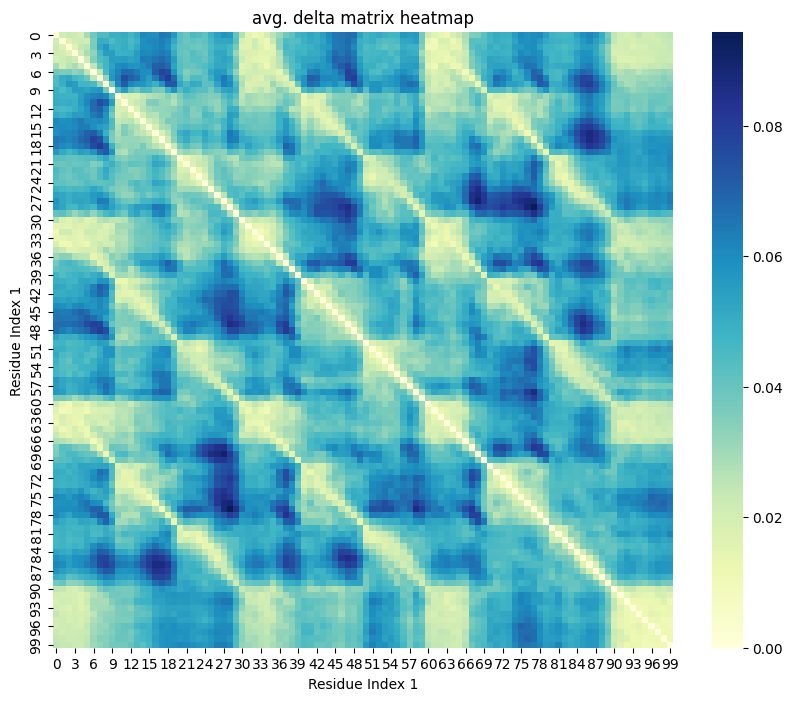

0.6259
something wrong with clustering Q computation


In [23]:
res = redpandda_general.main_clustering_general(df, 2)

In [24]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0060


In [25]:
res_hdbscan

(array([13, 13, 13, 13, 13, 13,  8,  4, 10,  1, 11, 11, 11, 11, 11, 11, 12,
         9,  5,  2,  6,  6,  6,  6,  6,  6,  6,  7,  3,  0, 13, 13, 13, 13,
        13, 13,  8,  4, 10,  1, 11, 11, 11, 11, 11, 11, 12,  9,  5,  2,  6,
         6,  6,  6,  6,  6,  6,  7,  3,  0, 13, 13, 13, 13, 13, 13,  8,  4,
        10,  1, 11, 11, 11, 11, 11, 11, 12,  9,  5,  2,  6,  6,  6,  6,  6,
         6,  6,  6,  3,  0, -1, 14, 14, 14, 14, 14, 14, 14, 14, 14]),
 5.079323351315091,
 array([[0.99847952, 0.99880647, 0.99884193, ..., 0.99885258, 0.99886661,
         0.99888479],
        [0.99880647, 0.99847952, 0.99874709, ..., 0.99881702, 0.99885806,
         0.99886112],
        [0.99884193, 0.99874709, 0.99847952, ..., 0.99883491, 0.9988306 ,
         0.99886432],
        ...,
        [0.99885258, 0.99881702, 0.99883491, ..., 0.99847952, 0.99866592,
         0.99865938],
        [0.99886661, 0.99885806, 0.9988306 , ..., 0.99866592, 0.99847952,
         0.99866574],
        [0.99888479, 0.99886112, 0.99

In [26]:
res

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 [],
 [],
 [array([[ 0],
         [ 1],
         [ 2],
         [ 3],
         [ 4],
         [ 5],
         [ 6],
         [ 7],
         [ 8],
         [ 9],
         [10],
         [11],
         [12],
         [13],
         [14],
         [15],
         [16],
         [17],
         [18],
         [19],
         [20],
         [21],
         [22],
         [23],
         [24],
         [25],
         [26],
         [27],
         [28],
         [29],
         [30],
         [31],
         [32],
         [33],
         [34],
         [35],
         [36],
         [37],
         [38],
         [39],
         [40],
         [41],
         [42],
   

In [27]:
res_agglon = redpandda_general.main_clustering_general(df, None, clustering_algorithm="agglomerative")

something wrong with clustering Q computation


In [28]:
res_agglon

(array([87,  1, 91, 70, 77, 82,  2, 86, 80, 83, 79, 58, 64, 61, 73, 90, 94,
        96, 78, 75, 76, 63, 50, 84, 69, 53, 31, 51, 62, 72, 54, 60,  0,  0,
        93, 68, 66, 57, 89, 56, 88, 38, 55, 65, 46, 59, 95, 81, 26, 92, 32,
        41, 43, 67, 37, 71, 29, 30, 39, 85, 74,  1, 27, 45, 28, 49,  2, 36,
        13, 48, 47, 18, 44, 35, 52, 14, 17, 42, 21, 40, 20, 24, 33,  8, 34,
        23, 19,  6, 15, 16, 25,  7,  9, 22, 12, 11, 10,  5,  4,  3]),
 [],
 array([[0.        , 0.21502976, 0.2383494 , ..., 0.24535591, 0.25458558,
         0.26653942],
        [0.21502976, 0.        , 0.17597827, ..., 0.22197141, 0.24896256,
         0.25097152],
        [0.2383494 , 0.17597827, 0.        , ..., 0.23373162, 0.23089947,
         0.25307799],
        ...,
        [0.24535591, 0.22197141, 0.23373162, ..., 0.        , 0.12259211,
         0.11829219],
        [0.25458558, 0.24896256, 0.23089947, ..., 0.12259211, 0.        ,
         0.12247219],
        [0.26653942, 0.25097152, 0.25307799, ..., 0.

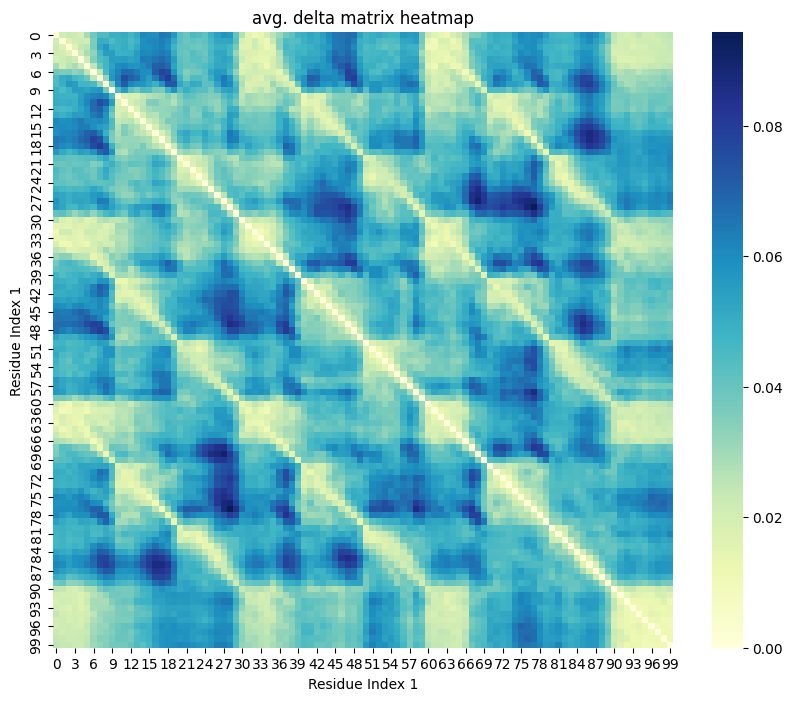

0.7080


In [29]:
res = redpandda_general.main_clustering_general(df, 6)

In [30]:
res_hdbscan = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan")

0.0058


In [31]:
res_hdbscan

(array([13, 13, 13, 13, 13, 13,  8,  4, 10,  1, 11, 11, 11, 11, 11, 11, 12,
         9,  5,  2,  6,  6,  6,  6,  6,  6,  6,  7,  3,  0, 13, 13, 13, 13,
        13, 13,  8,  4, 10,  1, 11, 11, 11, 11, 11, 11, 12,  9,  5,  2,  6,
         6,  6,  6,  6,  6,  6,  7,  3,  0, 13, 13, 13, 13, 13, 13,  8,  4,
        10,  1, 11, 11, 11, 11, 11, 11, 12,  9,  5,  2,  6,  6,  6,  6,  6,
         6,  6,  6,  3,  0, -1, 14, 14, 14, 14, 14, 14, 14, 14, 14]),
 5.079323351315091,
 array([[0.99847952, 0.99880647, 0.99884193, ..., 0.99885258, 0.99886661,
         0.99888479],
        [0.99880647, 0.99847952, 0.99874709, ..., 0.99881702, 0.99885806,
         0.99886112],
        [0.99884193, 0.99874709, 0.99847952, ..., 0.99883491, 0.9988306 ,
         0.99886432],
        ...,
        [0.99885258, 0.99881702, 0.99883491, ..., 0.99847952, 0.99866592,
         0.99865938],
        [0.99886661, 0.99885806, 0.9988306 , ..., 0.99866592, 0.99847952,
         0.99866574],
        [0.99888479, 0.99886112, 0.99

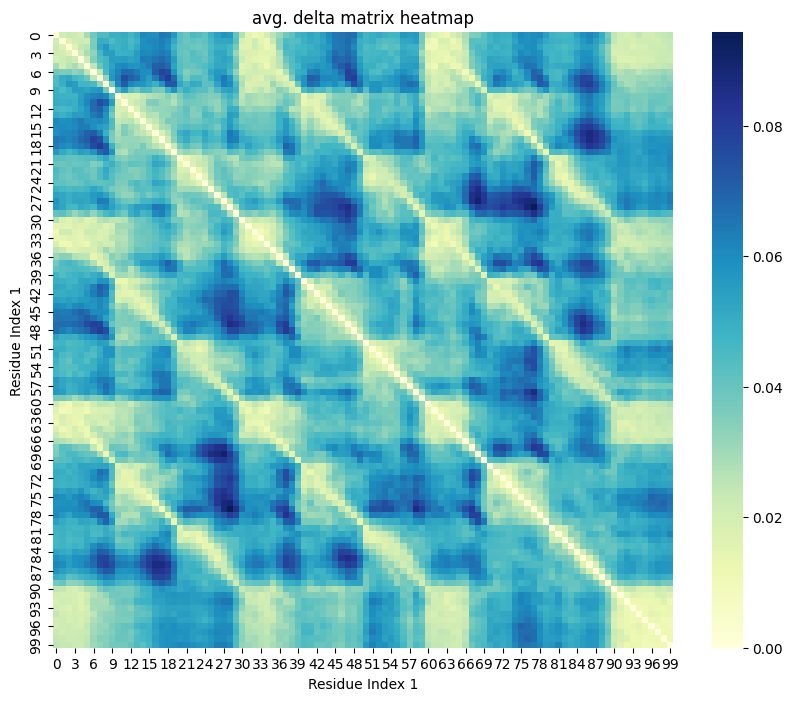

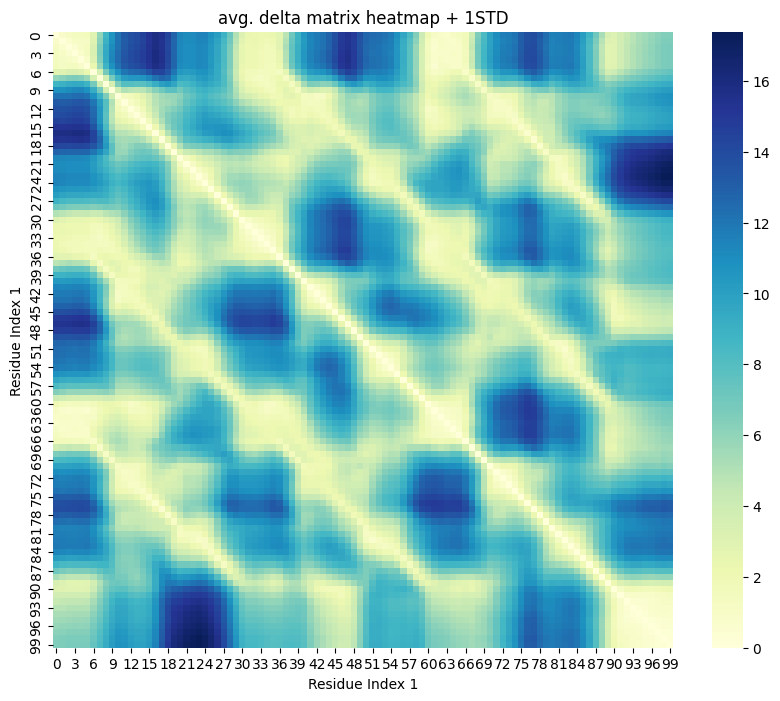

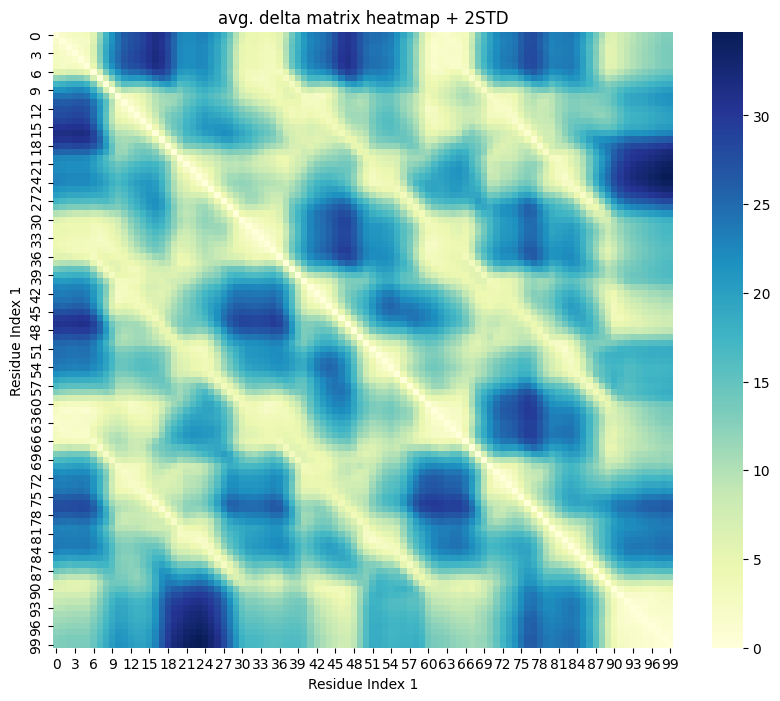

1.6503


In [32]:
res_specvar = redpandda_general.main_clustering_general_std(df, None)

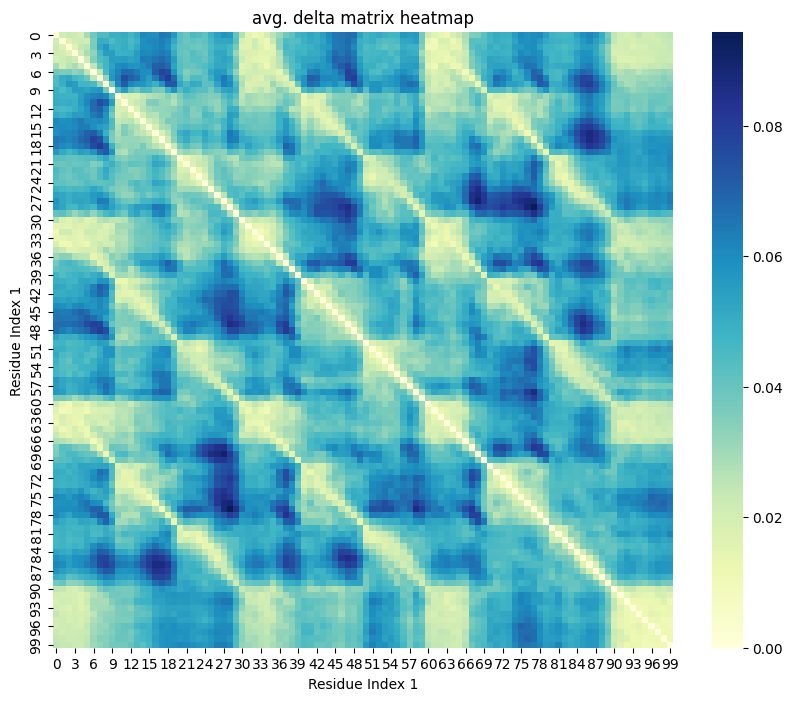

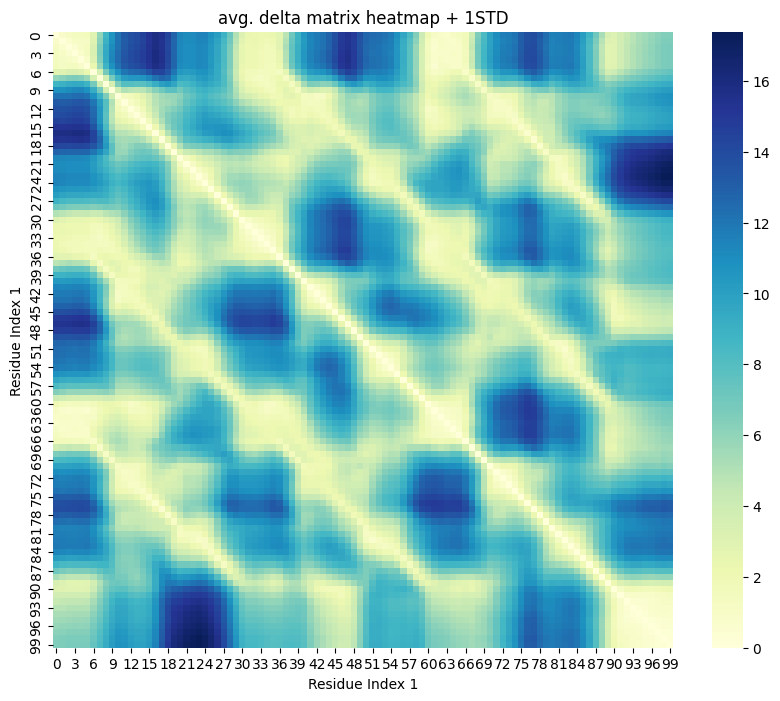

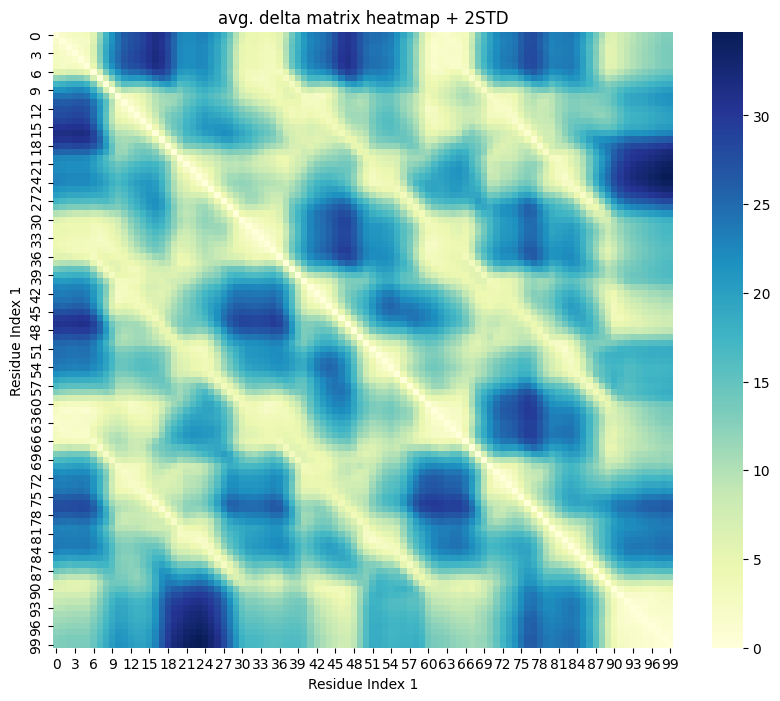

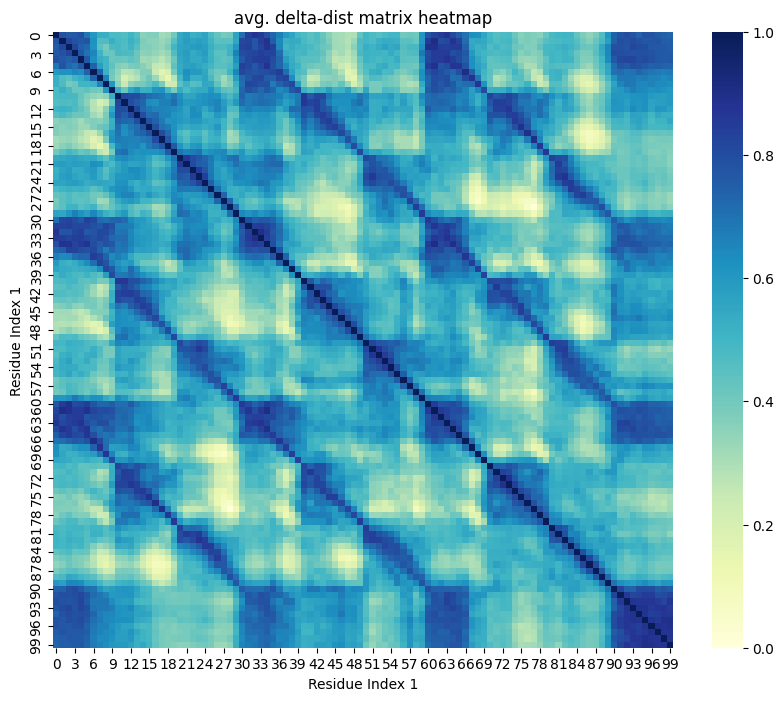

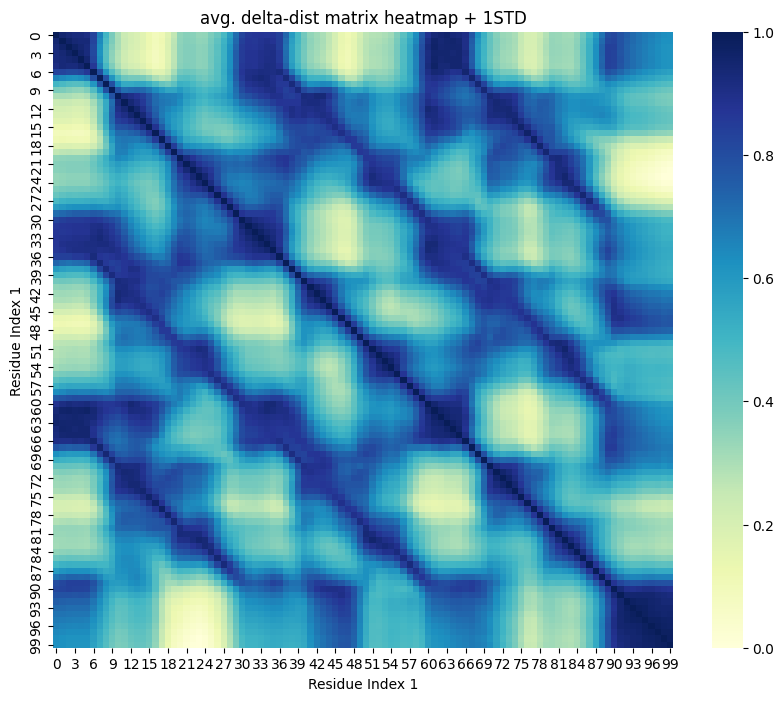

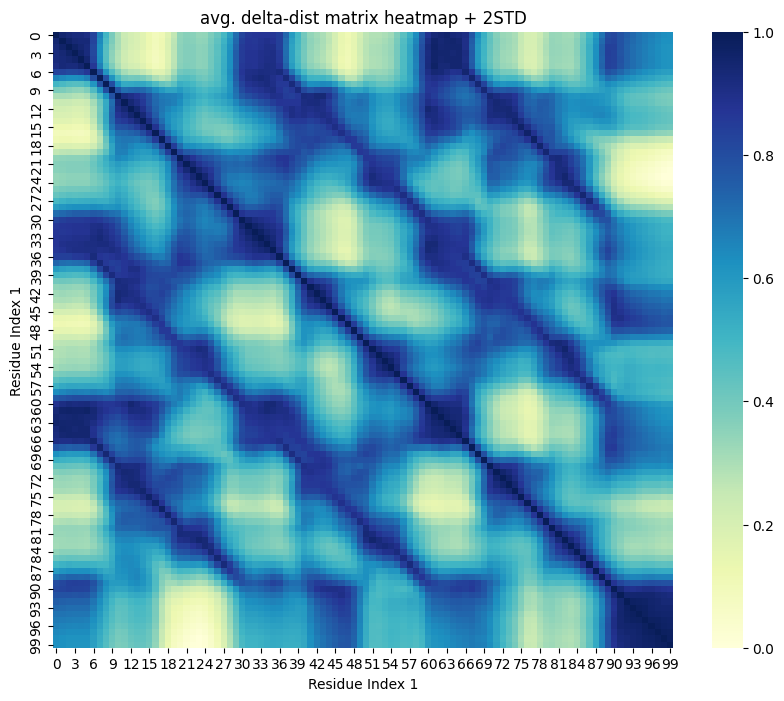

4.8718


In [33]:
res_specvar_distance = redpandda_general.main_clustering_general_std_distance(df, None)

In [34]:
result_labels = res[0]

In [35]:
result_labels

array([3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 5, 5, 5, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 4, 4, 4, 4,
       4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3,
       2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 5, 5, 5, 5, 5, 5,
       5, 5, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3])

In [36]:
trajectories_results = []
for ip, particle_traj in enumerate(trajectories):
    trajectory_result = []

    for it, timestep in enumerate(particle_traj):
        trajectory_result.append([*timestep[:-1], result_labels[ip]])
    trajectories_results.append(trajectory_result)

In [37]:
trajectories_results = [
    [[*timestep[:-1], result_labels[ip]] for timestep in particle_traj]
    for ip, particle_traj in enumerate(trajectories)
]

In [38]:
traj_array, point_array, frames_count, n_objects = redpandda_general.prepare_data_from_df(df)

In [39]:
dist_matrices = redpandda_general.get_distance_matrices(traj_array)
delta_matrices = redpandda_general.get_delta_matrices(dist_matrices)
average_delta_matrix = redpandda_general.calculate_average_delta_matrix(delta_matrices)

std_delta_matrix = redpandda_general.get_std_matrices(dist_matrices)

In [40]:
std_delta_matrix

array([[0.        , 0.83945985, 1.12396764, ..., 6.1342725 , 6.42679201,
        6.48201909],
       [0.83945985, 0.        , 0.64025366, ..., 6.22059041, 6.50816728,
        6.56217484],
       [1.12396764, 0.64025366, 0.        , ..., 6.3145031 , 6.57894651,
        6.63795504],
       ...,
       [6.1342725 , 6.22059041, 6.3145031 , ..., 0.        , 0.33236342,
        0.37068292],
       [6.42679201, 6.50816728, 6.57894651, ..., 0.33236342, 0.        ,
        0.29084153],
       [6.48201909, 6.56217484, 6.63795504, ..., 0.37068292, 0.29084153,
        0.        ]])

In [41]:
summed_delta_matrix = average_delta_matrix

In [42]:
summed_delta_matrix_1std = summed_delta_matrix + std_delta_matrix 
summed_delta_matrix_2std = summed_delta_matrix + std_delta_matrix * 2

In [43]:
from distance_matrix import *

In [44]:
normed_delta_matrix = 1 - normed_values(summed_delta_matrix)
normed_delta_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

In [45]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)
normed_similarity_matrix_1std = 1 - normed_values(summed_delta_matrix_1std)
normed_similarity_matrix_2std = 1 - normed_values(summed_delta_matrix_2std)

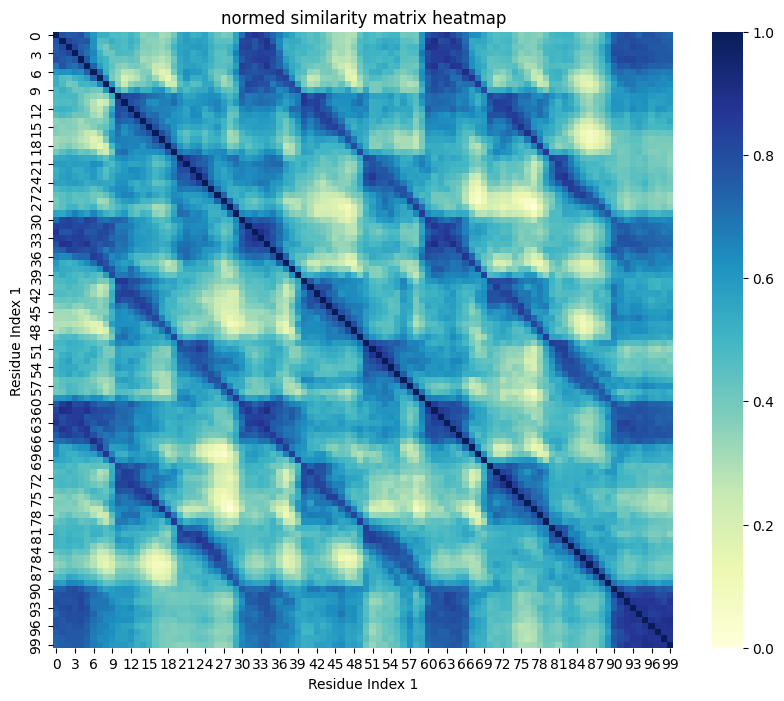

In [46]:
create_delta_heatmap(normed_similarity_matrix, title="normed similarity matrix heatmap")

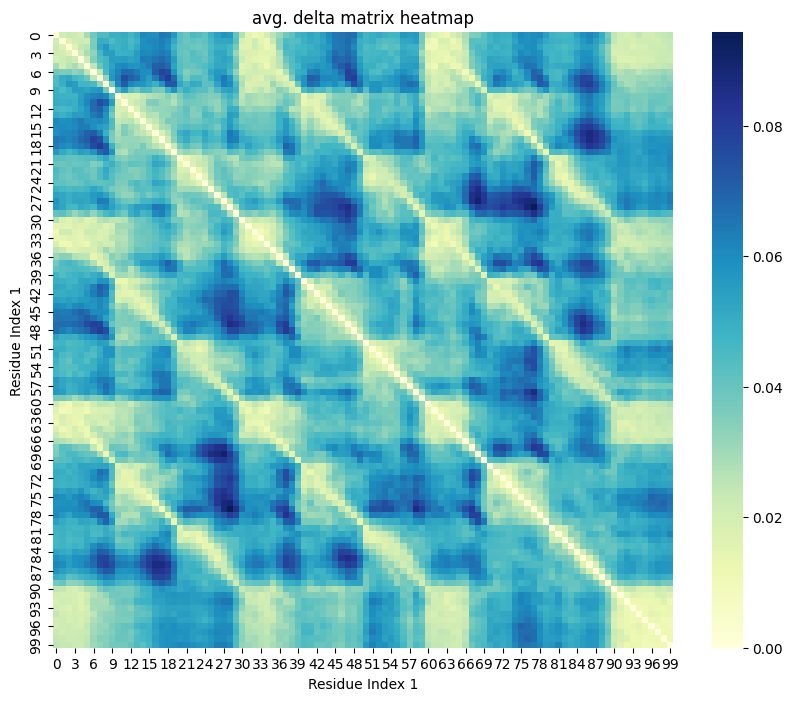

In [47]:
import distance_matrix
distance_matrix.create_delta_heatmap(average_delta_matrix, title="avg. delta matrix heatmap")

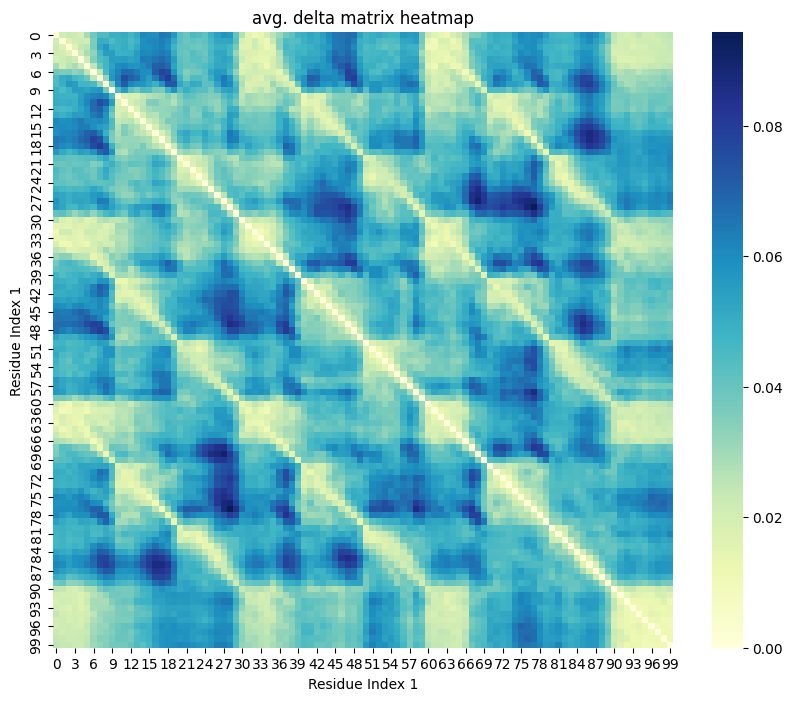

0.6022


array([5, 5, 5, 5, 5, 5, 5, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 5, 5, 1, 1, 1, 3, 3, 3, 3,
       2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0, 5, 5, 5, 5, 2, 2,
       1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 4, 4, 4, 4,
       4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [48]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [49]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(normed_similarity_matrix)

In [50]:
result.labels_

array([5, 5, 5, 5, 5, 5, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 5, 5, 5,
       1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 4, 4, 4, 4,
       4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5], dtype=int32)

In [51]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[1 1 1 1 1 1 1 1 4 4 4 4 5 5 5 5 5 5 4 4 4 4 4 4 0 0 5 5 5 5 3 3 3 3 3 3 3
 3 3 3 3 3 3 1 1 1 1 1 1 1 3 3 3 3 1 1 4 0 0 0 0 0 0 2 2 2 2 2 2 2 2 2 2 2
 2 0 0 0 2 2 2 2 2 2 2 2 2 4 4 4 4 4 5 5 5 5 5 5 5 5]


In [52]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 2 2 2 2
 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]


In [53]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result.labels_)

[ 1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1 -1  0  0  0  0
  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1
 -1 -1  0  0  0  0  0  0  0  0  0 -1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1 -1 -1 -1  0  0  0  0  0  0  0 -1 -1 -1  2  2  2  2  2  2
  2  2  2  2]


In [54]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[ 6  6  6  6  6  6 -1 -1 -1 -1  4  7  6 -1 -1 -1 -1 -1 -1 -1  1  1  1  1
  1  1  1  0 -1 -1 -1  5  5  5  5 -1 -1  3 -1 -1 -1 -1  4  4 -1 -1 -1 -1
 -1 -1  1  1  1  1  1  1  1  0 -1 -1  6  6  6  6  6  6 -1  3 -1 -1 -1  7
  7  7  7 -1 -1 -1 -1 -1  1  1  1  1  1  1  0 -1 -1 -1  2  2  2  2  2  2
  2  2  2  2]


In [55]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

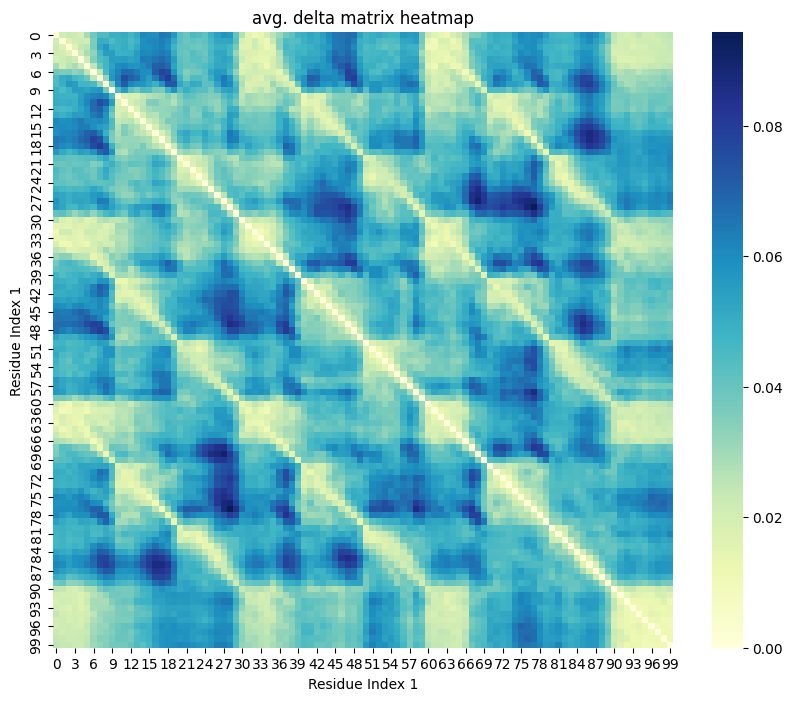

0.5353


array([2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 4, 4, 4, 4, 4, 3, 3, 3, 3, 2, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 4, 4, 4, 4,
       4, 3, 3, 3, 3, 3, 5, 5, 5, 5, 5, 5, 0, 0, 0, 5, 2, 2, 2, 2, 2, 2,
       1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [56]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [57]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result = clustering.fit(average_delta_matrix)

In [58]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result = clustering.fit(summed_delta_matrix_2std)

In [59]:
result.labels_

array([80, 50, 91, 53, 75, 92, 73, 72, 68, 61, 64, 67, 81, 77, 78, 87, 89,
       95, 83, 69, 54, 63, 85, 70, 34, 60, 71, 58, 82, 93, 76, 90, 94, 74,
       79, 56, 39, 49, 51, 88, 33, 48, 40, 57, 84, 35, 16, 59, 52, 55, 62,
       41, 28, 86, 45, 42, 46, 43, 65, 36, 29, 25, 66, 44, 31, 17, 30, 96,
       37, 27, 14, 19, 20, 38, 47, 21, 18, 22,  9, 32, 13, 24, 26, 12, 23,
       15,  6,  7, 11,  8,  5,  3, 10,  0,  0,  2,  4,  4,  1,  1])

In [60]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[ 6  6  6  6  6  6 -1 -1 -1 -1  4  7  6 -1 -1 -1 -1 -1 -1 -1  1  1  1  1
  1  1  1  0 -1 -1 -1  5  5  5  5 -1 -1  3 -1 -1 -1 -1  4  4 -1 -1 -1 -1
 -1 -1  1  1  1  1  1  1  1  0 -1 -1  6  6  6  6  6  6 -1  3 -1 -1 -1  7
  7  7  7 -1 -1 -1 -1 -1  1  1  1  1  1  1  0 -1 -1 -1  2  2  2  2  2  2
  2  2  2  2]


In [61]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result.labels_)

[ 7  7  7  7  7  7  6  5 -1  2  3  3  3  3  3  3  3  3  3  4  0  0  0  0
  0  0  0  0  0  1  7  7  7  7  7  7  6  5 -1  2  3  3  3  3  3  3  3  3
  3  4  0  0  0  0  0  0  0  0  0  1  7  7  7  7  7  7  6  5 -1  2  3  3
  3  3  3  3  3  3  3  4  0  0  0  0  0  0  0  0  0  1 -1  8  8  8  8  8
  8  8  8  8]


In [62]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result = clustering.fit(normed_delta_matrix_2std.astype(np.float64))

print(result.labels_)

[ 6  6  6  6  6  6 -1 -1 -1 -1  4  7  6 -1 -1 -1 -1 -1 -1 -1  1  1  1  1
  1  1  1  0 -1 -1 -1  5  5  5  5 -1 -1  3 -1 -1 -1 -1  4  4 -1 -1 -1 -1
 -1 -1  1  1  1  1  1  1  1  0 -1 -1  6  6  6  6  6  6 -1  3 -1 -1 -1  7
  7  7  7 -1 -1 -1 -1 -1  1  1  1  1  1  1  0 -1 -1 -1  2  2  2  2  2  2
  2  2  2  2]


In [63]:
#FF

In [64]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6 = clustering.fit(normed_similarity_matrix)

clustering = SpectralClustering(n_clusters=3, affinity='precomputed')
result_spectral_3 = clustering.fit(normed_similarity_matrix)

In [65]:
clustering = SpectralClustering(n_clusters=4, affinity='precomputed')
result_spectral_4 = clustering.fit(normed_similarity_matrix)

In [66]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)

In [67]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="discretize")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 1, 1, 1, 1, 2, 2, 2, 3, 3,
       3, 3, 3, 3, 2, 2, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 0, 0, 0, 0,
       1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 5, 5, 3, 3, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 3, 3, 3, 3, 3, 0, 0, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5])

In [68]:
clustering = SpectralClustering(n_clusters=3, affinity='precomputed', assign_labels="discretize")
result_spectral_3_discr = clustering.fit(normed_similarity_matrix)
result_spectral_3_discr.labels_

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [69]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed', assign_labels="cluster_qr")
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 3, 3, 3, 3, 4, 4, 0, 0, 2, 4, 4, 4,
       4, 4, 4, 4, 4, 2, 4, 4, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 3, 3, 3, 2,
       1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 0, 1, 0, 0, 3, 5, 5, 5, 5, 5, 5,
       2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 0, 0, 0, 0, 0,
       0, 0, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5])

In [70]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result_spectral_6_discr = clustering.fit(normed_similarity_matrix)
result_spectral_6_discr.labels_

array([1, 1, 1, 1, 1, 1, 5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 5, 5, 5, 5, 0, 0, 0, 0,
       4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
       5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 3, 3, 3,
       3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32)

In [71]:
result_spectral_3.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [72]:
result_spectral_6.labels_

array([0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 0, 0, 0, 0, 0, 0,
       4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 1, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32)

In [73]:
result_spectral_6_discr.labels_

array([1, 1, 1, 1, 1, 1, 5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 5, 5, 5, 5, 0, 0, 0, 0,
       4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1,
       5, 5, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 3, 3, 3, 3,
       3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32)

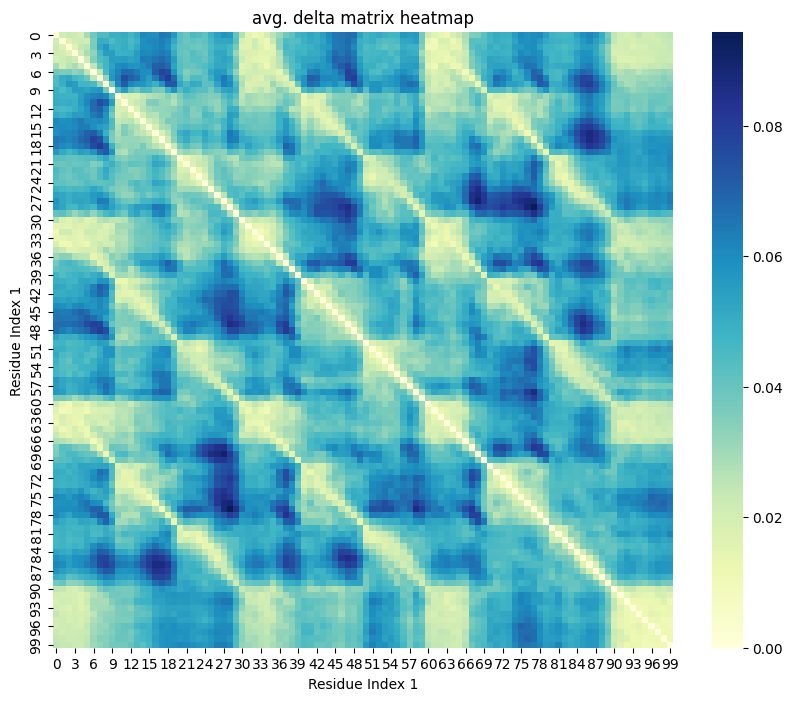

0.7252


array([3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 0, 0,
       0, 0, 0, 0, 1, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 5, 5, 5, 2, 2, 2, 2,
       2, 5, 5, 1, 1, 1, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 4, 4, 4, 4, 4,
       4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5])

In [74]:
distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, 6)

In [75]:
normed_similarity_matrix = 1 - normed_values(summed_delta_matrix)


In [76]:
clustering = SpectralClustering(n_clusters=6, affinity='precomputed')
result = clustering.fit(summed_delta_matrix_2std)
print(result.labels_)

[0 0 0 0 0 0 0 0 0 3 3 3 1 1 1 1 1 3 3 3 3 3 3 3 1 1 1 1 1 1 2 2 2 2 2 2 2
 2 2 2 2 2 5 5 0 0 0 0 0 0 2 2 2 2 0 0 5 5 5 5 5 5 5 4 4 4 4 4 4 4 4 4 4 4
 4 5 5 5 4 4 4 4 4 4 4 4 3 3 3 3 3 3 1 1 1 1 1 1 1 1]


In [77]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 

result_hdbscan_4_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_4_2.labels_)

[1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 2 2 2 2
 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]


In [78]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=4, min_samples=2, metric='precomputed') 


result_hdbscan_4_2_1std = clustering.fit(summed_delta_matrix_1std.astype(np.float64))

print(result_hdbscan_4_2_1std.labels_)

[ 1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1 -1  0  0  0  0
  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1 -1 -1
 -1 -1  0  0  0  0  0  0  0  0  0 -1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1 -1 -1 -1  0  0  0  0  0  0  0 -1 -1 -1  2  2  2  2  2  2
  2  2  2  2]


In [79]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2_2std = clustering.fit(summed_delta_matrix_2std.astype(np.float64))

print(result_hdbscan_2_2_2std.labels_)

[ 6  6  6  6  6  6 -1 -1 -1 -1  4  7  6 -1 -1 -1 -1 -1 -1 -1  1  1  1  1
  1  1  1  0 -1 -1 -1  5  5  5  5 -1 -1  3 -1 -1 -1 -1  4  4 -1 -1 -1 -1
 -1 -1  1  1  1  1  1  1  1  0 -1 -1  6  6  6  6  6  6 -1  3 -1 -1 -1  7
  7  7  7 -1 -1 -1 -1 -1  1  1  1  1  1  1  0 -1 -1 -1  2  2  2  2  2  2
  2  2  2  2]


In [80]:
normed_delta_matrix = normed_values(summed_delta_matrix)
normed_delta_matrix_1std = normed_values(summed_delta_matrix_1std)
normed_delta_matrix_2std =  normed_values(summed_delta_matrix_2std)

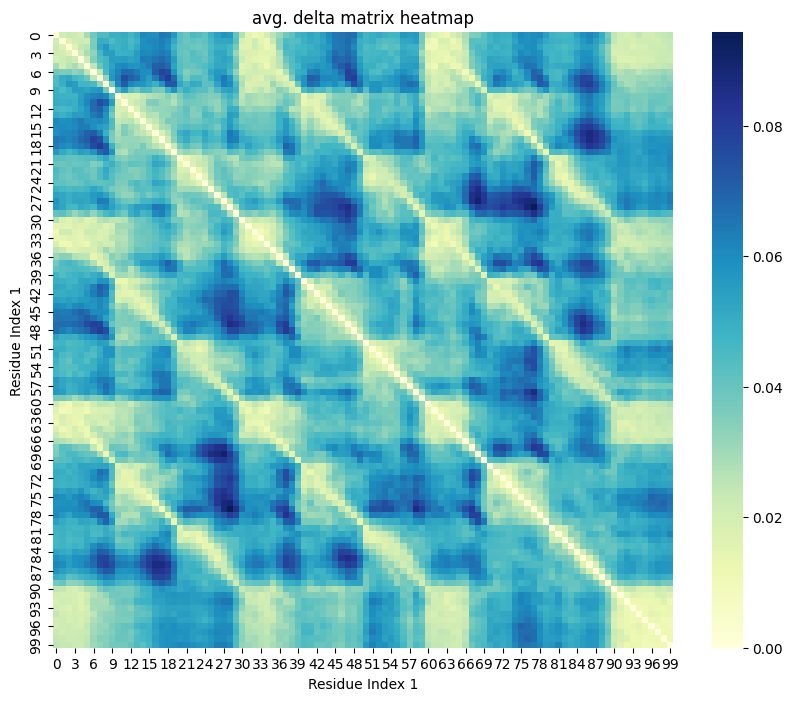

0.5272


array([2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 0, 0, 0, 0, 0, 4, 4, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 5, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 0, 0, 0, 0,
       4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 3, 2, 2, 2,
       3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [81]:
spectral_clustering_on_deltas(average_delta_matrix, 6)

In [82]:
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.1, affinity='precomputed', linkage='complete')

result_agglo_compl_dt01 = clustering.fit(average_delta_matrix)

In [83]:

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, metric='precomputed', linkage='complete')

result_agglo_compl_dt07_2std  = clustering.fit(summed_delta_matrix_2std)

In [84]:

clustering = AgglomerativeClustering(n_clusters=3, metric='precomputed', linkage='complete')

result_agglo_cl3  = clustering.fit(average_delta_matrix)

In [85]:
result_agglo_compl_dt01.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [86]:
result_agglo_cl3.labels_

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [87]:
import hdbscan

clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2, metric='precomputed') 


result_hdbscan_2_2 = clustering.fit(summed_delta_matrix.astype(np.float64))

print(result_hdbscan_2_2.labels_)

[ 7  7  7  7  7  7  6  5 -1  2  3  3  3  3  3  3  3  3  3  4  0  0  0  0
  0  0  0  0  0  1  7  7  7  7  7  7  6  5 -1  2  3  3  3  3  3  3  3  3
  3  4  0  0  0  0  0  0  0  0  0  1  7  7  7  7  7  7  6  5 -1  2  3  3
  3  3  3  3  3  3  3  4  0  0  0  0  0  0  0  0  0  1 -1  8  8  8  8  8
  8  8  8  8]


In [88]:
result_hdbscan_2_2_2std.labels_

array([ 6,  6,  6,  6,  6,  6, -1, -1, -1, -1,  4,  7,  6, -1, -1, -1, -1,
       -1, -1, -1,  1,  1,  1,  1,  1,  1,  1,  0, -1, -1, -1,  5,  5,  5,
        5, -1, -1,  3, -1, -1, -1, -1,  4,  4, -1, -1, -1, -1, -1, -1,  1,
        1,  1,  1,  1,  1,  1,  0, -1, -1,  6,  6,  6,  6,  6,  6, -1,  3,
       -1, -1, -1,  7,  7,  7,  7, -1, -1, -1, -1, -1,  1,  1,  1,  1,  1,
        1,  0, -1, -1, -1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2])

In [89]:
groups_list = np.array(trajectories)[:,:,-1]
num_groups = len(np.unique(np.array(groups_list).flatten()))

In [90]:
true_labels = groups_list[:,0]

In [91]:
true_labels

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [92]:
residue_items = list(range(len(true_labels)))

In [93]:
import visualizations


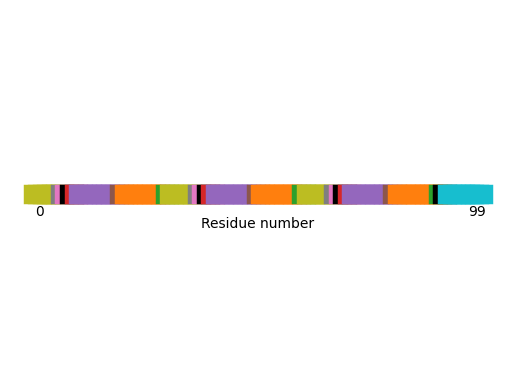

In [94]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

In [95]:
from sklearn.cluster import AffinityPropagation

In [96]:
clustering_aff = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix.astype(np.float64))
clustering_aff_1std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_1std.astype(np.float64))
clustering_aff_2std = AffinityPropagation(random_state=5, affinity="precomputed").fit(normed_similarity_matrix_2std.astype(np.float64))

In [97]:
clustering.labels_

array([ 7,  7,  7,  7,  7,  7,  6,  5, -1,  2,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  4,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  7,  7,  7,  7,
        7,  7,  6,  5, -1,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  1,  7,  7,  7,  7,  7,  7,  6,  5,
       -1,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  1, -1,  8,  8,  8,  8,  8,  8,  8,  8,  8])

In [98]:
clustering_aff_1std.labels_

array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 0, 0, 0, 4, 4, 1, 5, 5, 5, 6, 6,
       6, 6, 6, 6, 7, 7, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 2, 2, 2,
       2, 1, 1, 1, 5, 5, 6, 6, 6, 6, 6, 7, 7, 3, 3, 3, 4, 4, 4, 4, 4, 4,
       4, 2, 2, 2, 0, 0, 0, 0, 0, 1, 1, 1, 5, 5, 6, 6, 6, 6, 7, 7, 7, 3,
       3, 2, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8])

In [99]:
clustering_aff_2std.labels_

array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 0, 0, 0, 4, 4, 1, 5, 5, 5, 6, 6,
       6, 6, 6, 6, 7, 7, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 2, 2, 2,
       2, 1, 1, 1, 5, 5, 6, 6, 6, 6, 6, 7, 7, 3, 3, 3, 4, 4, 4, 4, 4, 4,
       4, 2, 2, 2, 0, 0, 0, 0, 0, 1, 1, 1, 5, 5, 6, 6, 6, 6, 7, 7, 7, 3,
       3, 2, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8])

In [100]:
res_hdbscan_2_1 = redpandda_general.main_clustering_general(df, None, clustering_algorithm="hdbscan", min_cluster_size=2, min_samples=1)

0.0104


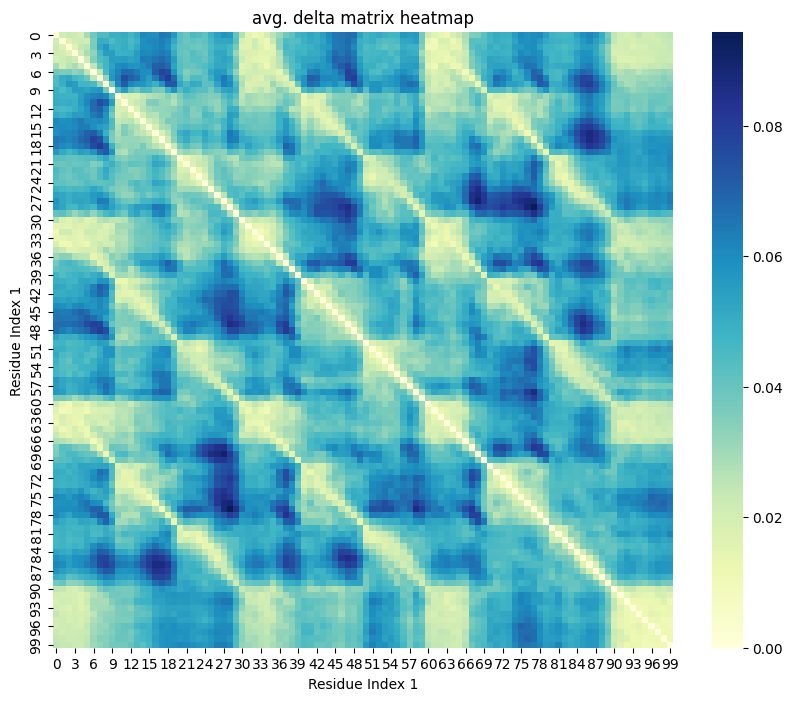

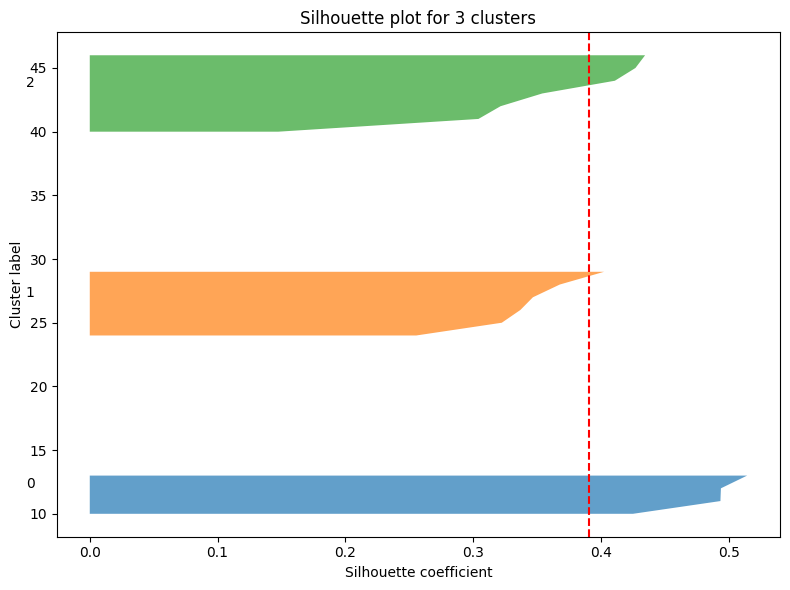

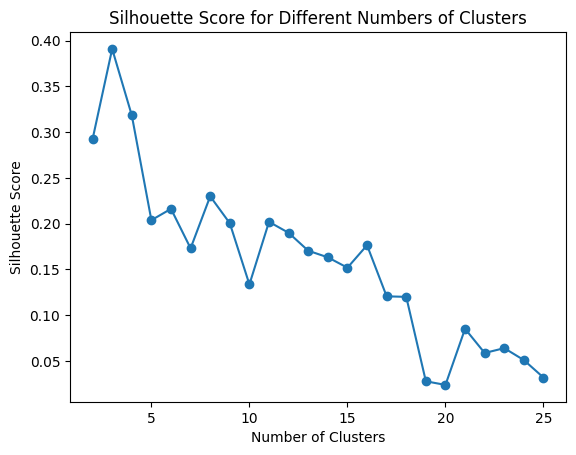

1.2448


In [101]:
spectral_opt_sil = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix, cluster_count=None, silhouette = True)
spectral_opt_sil = list(spectral_opt_sil)


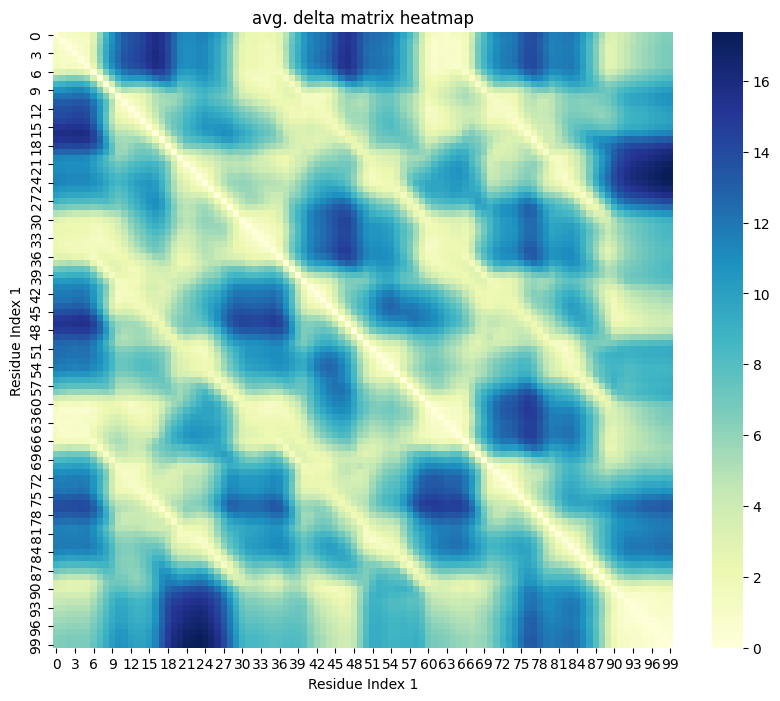

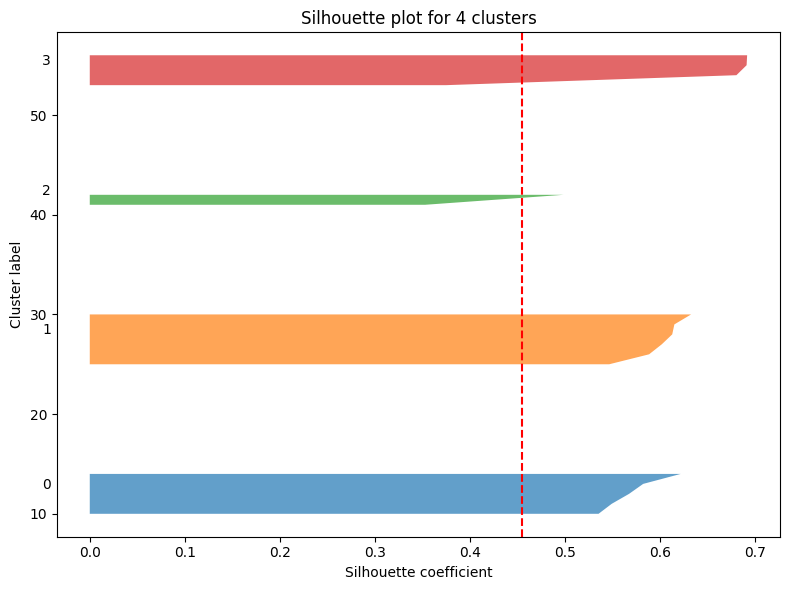

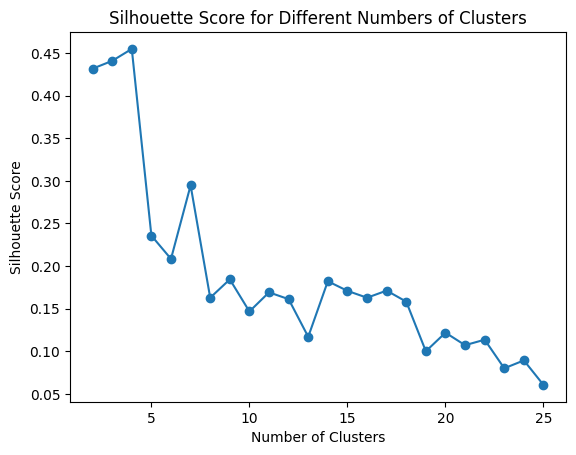

1.3195


In [102]:
spectral_opt_sil_1std = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix_1std, cluster_count=None, silhouette = True)
spectral_opt_sil_1std = list(spectral_opt_sil_1std)

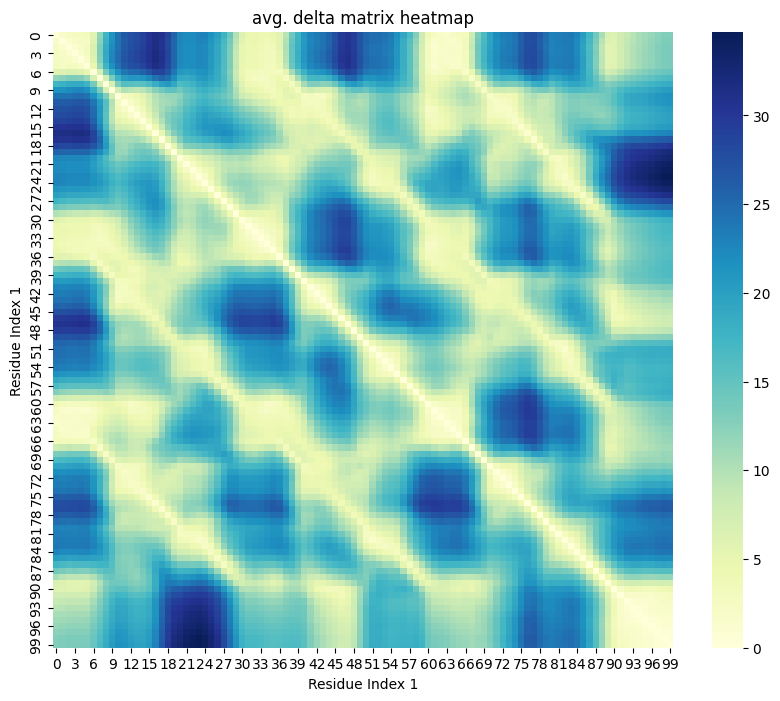

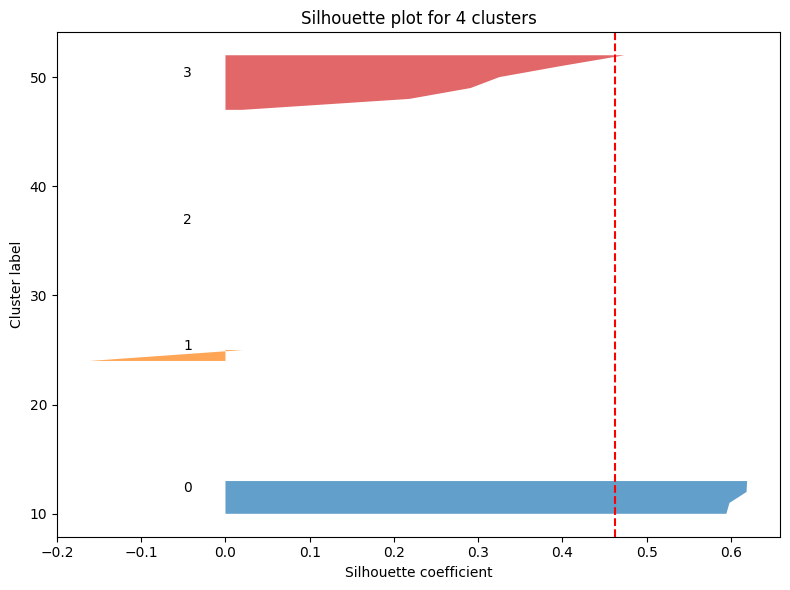

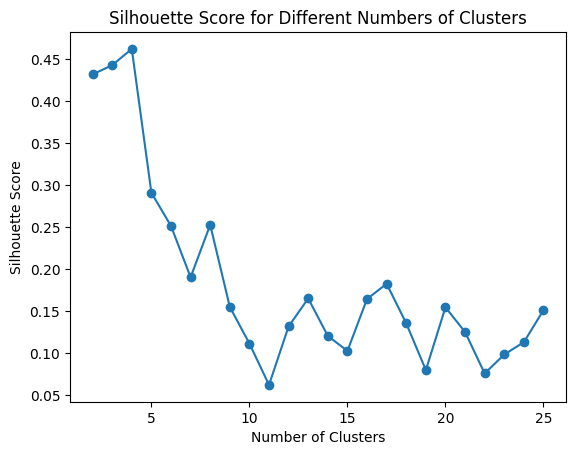

1.3635


In [103]:
spectral_opt_sil_2std = distance_matrix.spectral_clustering_on_deltas(summed_delta_matrix_2std, cluster_count=None, silhouette = True)
spectral_opt_sil_2std = list(spectral_opt_sil_2std)

In [104]:
clustering_names = []
clustering_results = []

clustering_names.append("hdbscan, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2_1[0]))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:1")
clustering_results.append(list(res_hdbscan_2std[0]))

clustering_names.append("hdbscan, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2.labels_))
clustering_names.append("hdbscan, +2std, min_cluster:2, min_samples:2")
clustering_results.append(list(result_hdbscan_2_2_2std.labels_))
clustering_names.append("hdbscan, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2.labels_))
clustering_names.append("hdbscan, +1std, min_cluster:4, min_samples:2")
clustering_results.append(list(result_hdbscan_4_2_1std.labels_))



clustering_names.append("spectral,  clusters:6")
clustering_results.append(list(result_spectral_6.labels_))
clustering_names.append("spectral,  clusters:3")
clustering_results.append(list(result_spectral_3.labels_))
clustering_names.append("spectral,  clusters:4")
clustering_results.append(list(result_spectral_4.labels_))

clustering_names.append("affinity prop")
clustering_results.append(list(clustering_aff.labels_))
clustering_names.append("affinity prop, +1std")
clustering_results.append(list(clustering_aff_1std.labels_))
clustering_names.append("affinity prop, +2std")
clustering_results.append(list(clustering_aff_2std.labels_))

clustering_names.append("spectra, opt.silh.")
clustering_results.append(list(spectral_opt_sil))
clustering_names.append("spectra, opt.silh., +1std")
clustering_results.append(list(spectral_opt_sil_1std))
clustering_names.append("spectra, opt.silh., +2std")
clustering_results.append(list(spectral_opt_sil_2std))





In [105]:
import numpy as np
from scipy.optimize import linear_sum_assignment
from sklearn.metrics import confusion_matrix

def evaluate_clustering_nr_wrong_elements(true_labels, predicted_labels):

    cm = confusion_matrix(true_labels, predicted_labels)
    
    # Hungarian / Munkres algorithm
    row_ind, col_ind = linear_sum_assignment(-cm)
    
    correctly_clustered = cm[row_ind, col_ind].sum()
    
    total_items = len(true_labels)
    wrongly_clustered = total_items - correctly_clustered
    
    return wrongly_clustered

In [106]:
traj_array = np.array(trajectories)[:,:,:-1]

In [107]:
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [108]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))


In [109]:
result_hdbscan_2_2_flat.labels_


array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,
        2,  2, -1, -1,  9,  9,  9,  9,  9, 10, 10, 10, -1, -1,  5,  5,  5,
        5,  5, -1, -1, -1, -1, -1,  3,  3,  3,  3,  3,  3,  3, -1, -1, -1,
       11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 12, 12, 12, -1, -1,
       -1, -1,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  7,  7,  7,  7,
        7,  7,  8,  8, -1,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6])

In [110]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)

In [111]:
result_spectral_3_flat.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 1, 2, 0, 0], dtype=int32)

In [112]:
#vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)

In [113]:
def compute_velocities(points, delta_t=1):

    velocities = []
    
    for point_series in points:
        point_velocities = []
        for i in range(1, len(point_series)):
            velocity = [(point_series[i][j] - point_series[i-1][j]) / delta_t for j in range(3)]
            point_velocities.append(velocity)
        
        #let's assume starting velocity is 0
        point_velocities.insert(0, [0.0, 0.0, 0.0])
        velocities.append(point_velocities)
    
    return velocities

    
try:
    vels_to_cluster = process_data.simulation_to_array_velocities(particles_from_sim)
    traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
    flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

except:
    print("no simulation data with velocities")
    traj_array_vel = compute_velocities(traj_array)
    traj_array_vel = np.array(traj_array_vel)
    flattened_array_vel =  traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [114]:
traj_array = np.array(trajectories)[:,:,:-1]
flattened_array = traj_array.reshape(traj_array.shape[0], -1)

In [115]:
#traj_array_vel = np.array(vels_to_cluster)[:,:,:-1]
#flattened_array_vel = traj_array_vel.reshape(traj_array_vel.shape[0], -1)

In [116]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat = clustering.fit(flattened_array)
result_spectral_3_flat.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 1, 2, 0, 0], dtype=int32)

In [117]:
clustering = SpectralClustering(n_clusters=4)
result_spectral_4_flat = clustering.fit(flattened_array)
result_spectral_4_flat.labels_

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 3, 2, 0, 0], dtype=int32)

In [118]:
clustering = SpectralClustering(n_clusters=3)
result_spectral_3_flat_vel = clustering.fit(flattened_array_vel)
result_spectral_3_flat_vel.labels_

array([1, 1, 0, 1, 2, 1, 1, 1, 0, 1, 1, 1, 2, 1, 2, 1, 1, 0, 2, 2, 2, 2,
       2, 0, 1, 2, 0, 2, 0, 1, 1, 0, 2, 2, 0, 0, 1, 0, 0, 0, 0, 2, 1, 2,
       0, 0, 2, 2, 1, 2, 1, 2, 2, 1, 0, 0, 1, 0, 2, 2, 1, 2, 0, 1, 2, 2,
       2, 0, 2, 1, 1, 0, 1, 1, 2, 2, 2, 0, 0, 2, 1, 2, 0, 2, 1, 0, 2, 0,
       1, 2, 2, 0, 1, 2, 0, 1, 0, 2, 1, 1], dtype=int32)

In [119]:
clustering = SpectralClustering(n_clusters=4)
result_spectral_4_flat_vel = clustering.fit(flattened_array_vel)
result_spectral_4_flat_vel.labels_

array([3, 2, 3, 3, 3, 3, 2, 3, 1, 1, 3, 2, 2, 0, 1, 2, 2, 3, 3, 0, 1, 3,
       2, 0, 3, 3, 3, 0, 2, 0, 3, 3, 3, 2, 2, 3, 0, 1, 3, 2, 3, 3, 2, 3,
       1, 3, 3, 1, 1, 2, 1, 1, 3, 0, 3, 1, 2, 2, 2, 3, 3, 1, 3, 3, 2, 3,
       3, 2, 3, 3, 3, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 2, 3, 0, 2, 3, 2, 3,
       3, 1, 1, 1, 1, 3, 2, 3, 1, 2, 2, 2], dtype=int32)

In [120]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))
result_hdbscan_2_2_flat.labels_

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,
        2,  2, -1, -1,  9,  9,  9,  9,  9, 10, 10, 10, -1, -1,  5,  5,  5,
        5,  5, -1, -1, -1, -1, -1,  3,  3,  3,  3,  3,  3,  3, -1, -1, -1,
       11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 12, 12, 12, -1, -1,
       -1, -1,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  7,  7,  7,  7,
        7,  7,  8,  8, -1,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6])

In [121]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=1) 


result_hdbscan_2_1_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_1_flat_vel.labels_

array([ 9,  9,  9,  9,  9,  9, 10,  6,  4,  0,  8,  8,  8,  8,  8,  8,  7,
        5,  3,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  9,  9,  9,  9,
        9,  9, 10,  6,  4,  0,  8,  8,  8,  8,  8,  8,  7,  5,  3,  1,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  9,  9,  9,  9,  9,  9, 10,  6,
        4,  0,  8,  8,  8,  8,  8,  8,  7,  5,  3,  1,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9])

In [122]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat_vel.labels_

array([ 9,  9,  9,  9,  9,  9, 10,  6,  4,  0,  8,  8,  8,  8,  8,  8,  7,
        5,  3,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  9,  9,  9,  9,
        9,  9, 10,  6,  4,  0,  8,  8,  8,  8,  8,  8,  7,  5,  3,  1,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  9,  9,  9,  9,  9,  9, 10,  6,
        4,  0,  8,  8,  8,  8,  8,  8,  7,  5,  3,  1,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9])

In [123]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat = clustering.fit(flattened_array.astype(np.float64))
result_hdbscan_2_2_flat.labels_

clustering_names.append("hdbscan, flattened positions, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat.labels_))

In [124]:
clustering = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2) 


result_hdbscan_2_2_flat_vel = clustering.fit(flattened_array_vel.astype(np.float64))
result_hdbscan_2_2_flat_vel.labels_

clustering_names.append("hdbscan, flattened velocities, 2, 2")
clustering_results.append(list(result_hdbscan_2_2_flat_vel.labels_))

In [125]:

clustering_names.append("ground truth")
clustering_results.append(list(true_labels))

In [126]:
result_hdbscan_2_2.labels_

array([ 7,  7,  7,  7,  7,  7,  6,  5, -1,  2,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  4,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  7,  7,  7,  7,
        7,  7,  6,  5, -1,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  1,  7,  7,  7,  7,  7,  7,  6,  5,
       -1,  2,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  1, -1,  8,  8,  8,  8,  8,  8,  8,  8,  8])

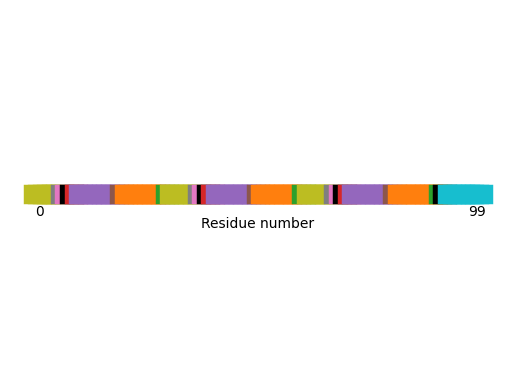

In [127]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2.labels_)

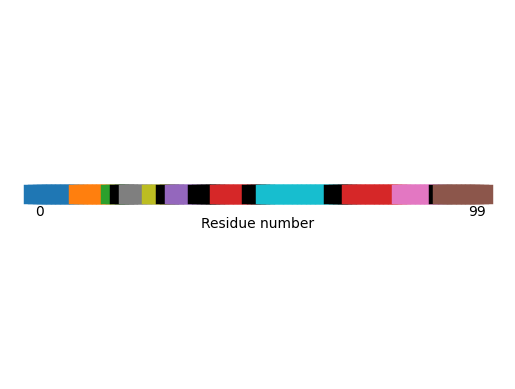

In [128]:
visualizations.plot_residue_line_plus_noise(residue_items, result_hdbscan_2_2_flat.labels_)

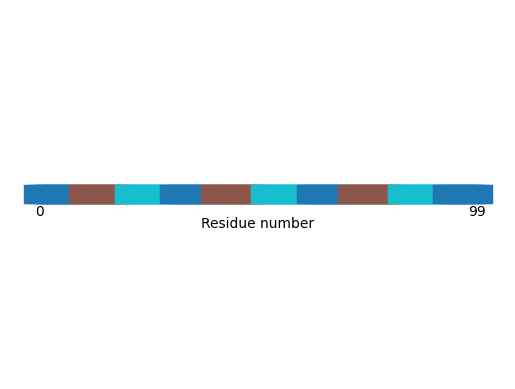

In [129]:
visualizations.plot_residue_line_plus_noise(residue_items, result_spectral_3.labels_)

In [130]:
import sklearn 
def get_clustering_similarity_true(true_clustering, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clustering, clusterings[i])
        sim_results.append(sim_result)
    return sim_results

def get_clustering_similarity_true_trajectories(true_clusterings, clusterings, sim_function = sklearn.metrics.adjusted_rand_score):
    sim_results = []
    for i in range(len(clusterings)):
        sim_result = sim_function(true_clusterings[i], clusterings[i])
        sim_results.append(sim_result)
    return sim_result



Text(0.5, 1.0, 'adjusted rand score')

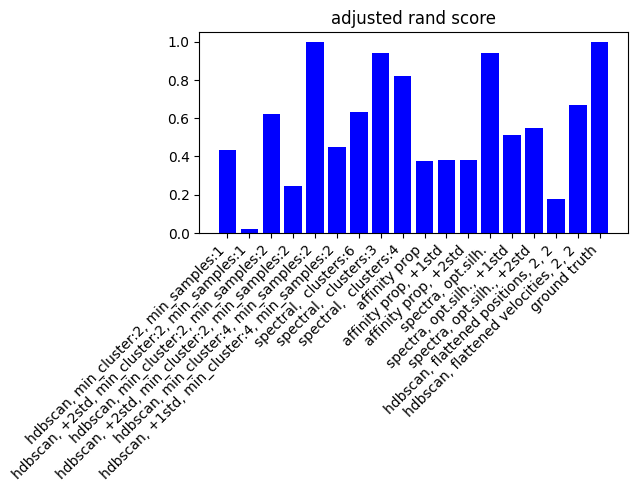

In [131]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("adjusted rand score")

Text(0.5, 1.0, 'nr. of wrong elements')

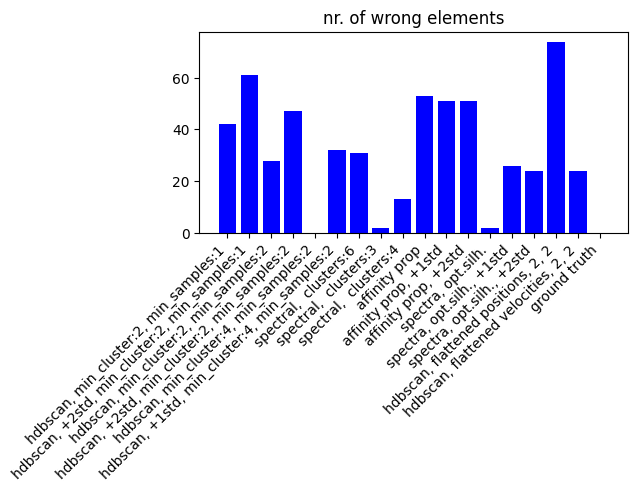

In [132]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, evaluate_clustering_nr_wrong_elements)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right')  

plt.tight_layout()

plt.title("nr. of wrong elements")

Text(0.5, 1.0, 'NMI')

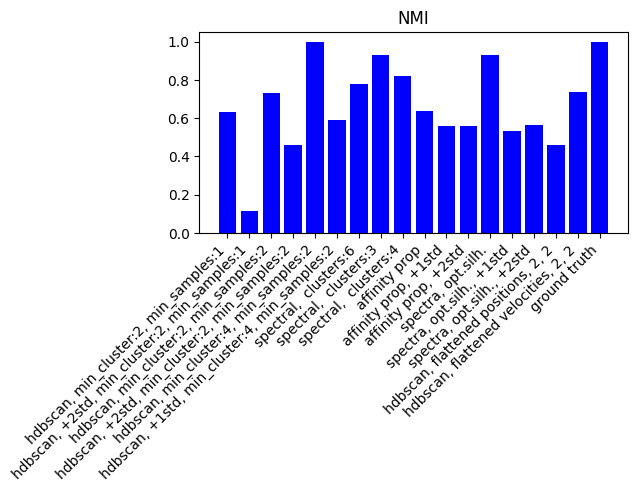

In [133]:
sim_scores = get_clustering_similarity_true(true_labels, clustering_results, sklearn.metrics.normalized_mutual_info_score)
plt.bar(clustering_names, sim_scores, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("NMI")

Text(0.5, 1.0, 'number of points class. as noise')

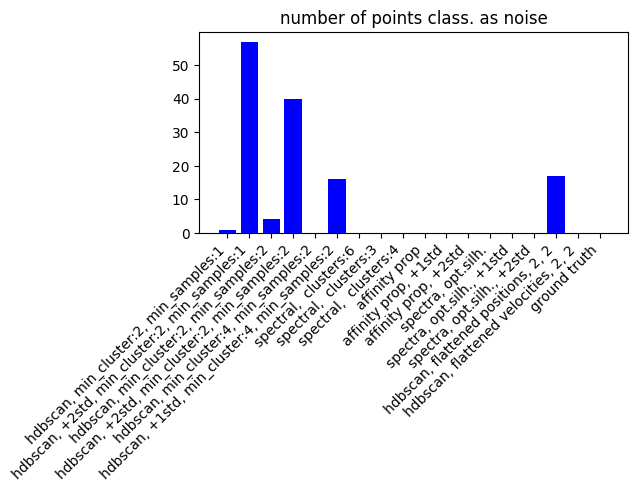

In [134]:
noise_elements = []
noise_int = -1
for res in clustering_results:
    noise_el = len(np.where(np.array(res)==noise_int)[0])
    noise_elements.append(noise_el)

plt.bar(clustering_names, noise_elements, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("number of points class. as noise")

Text(0.5, 1.0, 'number of clusters')

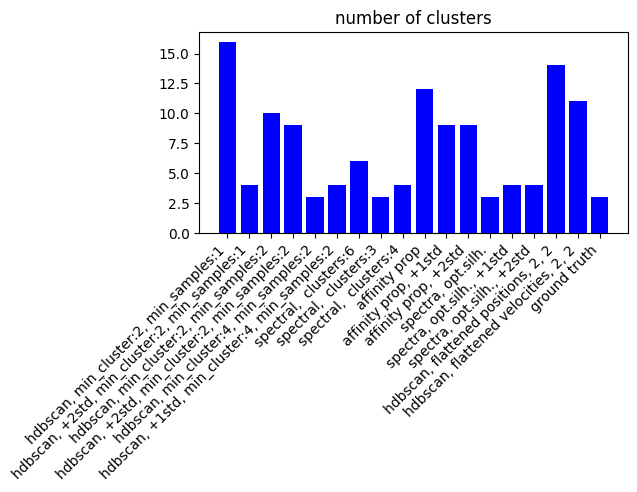

In [135]:

plt.bar(clustering_names, [len(np.unique(x)) for x in clustering_results], color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("number of clusters")

In [139]:
#Q calculations

clustering contains noise


clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_max from distance matrices, full, thinning=500')

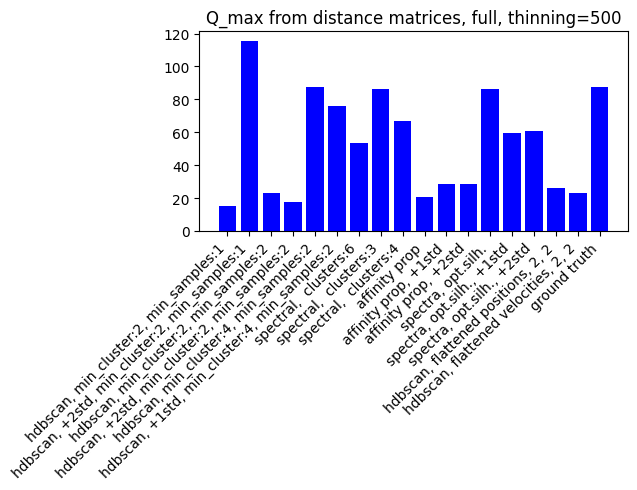

In [140]:
Qs = []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=500, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from distance matrices, full, thinning=500")

In [141]:
'''
Qs = []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from distance matrices, full")
'''

'\nQs = []\nfor res in clustering_results:\n\n    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)\n    Qs.append(new_dist_Q_max_value)\n\nplt.bar(clustering_names, Qs, color=\'blue\')\nplt.xticks(rotation=45, ha=\'right\') \n\nplt.tight_layout()\n\nplt.title("Q_max from distance matrices, full")\n'

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_mean from distance matrices, full, thinning 500')

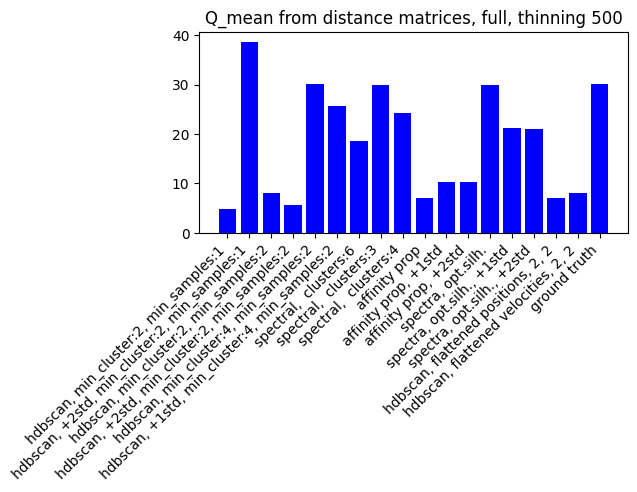

In [142]:
Qsf3= []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=500, only_adjacent=False, reference_frame=None, return_raw=False)
    Qsf3.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qsf3, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from distance matrices, full, thinning 500")

In [143]:
'''
Qsf3= []
for res in clustering_results:

    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)
    Qsf3.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qsf3, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from distance matrices, full")
'''

'\nQsf3= []\nfor res in clustering_results:\n\n    new_dist_Q_max_value, _ = get_Q_for_clustering_extended(dist_matrices, np.array(res), None, use_max=False, thinning_factor=None, only_adjacent=False, reference_frame=None, return_raw=False)\n    Qsf3.append(new_dist_Q_max_value)\n\nplt.bar(clustering_names, Qsf3, color=\'blue\')\nplt.xticks(rotation=45, ha=\'right\') \n\nplt.tight_layout()\n\nplt.title("Q_mean from distance matrices, full")\n'

clustering contains noise


clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_max from positions, Kabsch superimposition, full, thinning=100')

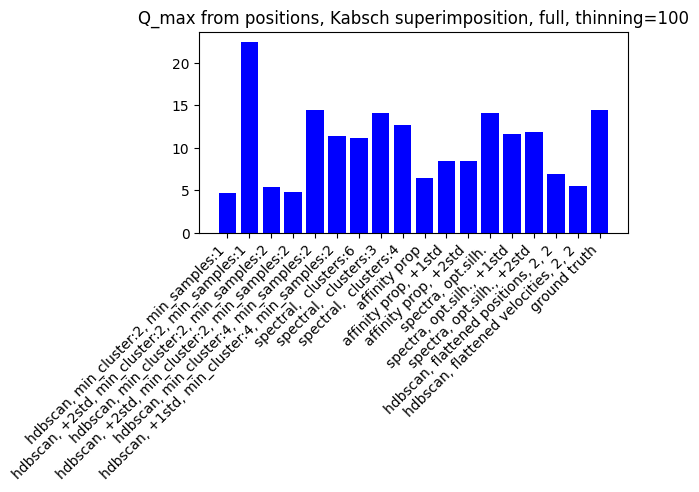

In [144]:

Qs = []

for res in clustering_results:


    new_dist_Q_max_value, _ = get_Q_for_clustering_positions(traj_array, np.array(res), None, use_max=True, apply_superimposition = "kabsch", thinning_factor=100, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_max from positions, Kabsch superimposition, full, thinning=100")

clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


Text(0.5, 1.0, 'Q_mean from positions, Kabsch superimposition, full, thinning 50')

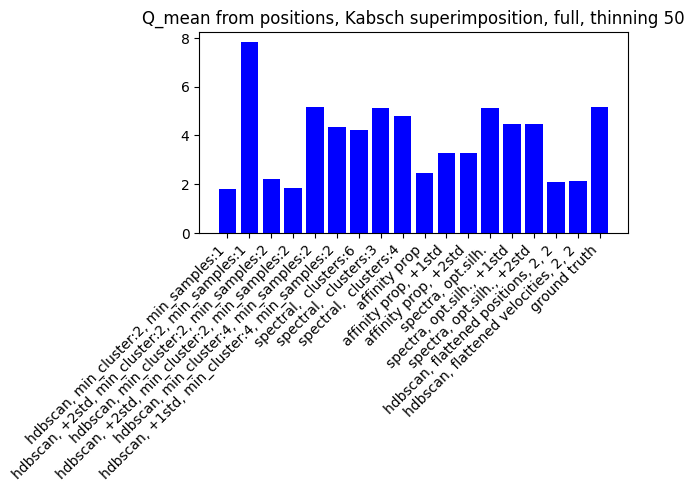

In [145]:
Qs = []

for res in clustering_results:


    new_dist_Q_max_value, _ = get_Q_for_clustering_positions(traj_array, np.array(res), None, use_max=False, apply_superimposition = "kabsch", thinning_factor=50, only_adjacent=False, reference_frame=None, return_raw=False)
    Qs.append(new_dist_Q_max_value)

plt.bar(clustering_names, Qs, color='blue')
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()

plt.title("Q_mean from positions, Kabsch superimposition, full, thinning 50")

In [146]:
#q computation fuer verschiedene cluster

In [147]:
import compare_clusterings
import numpy as np
from itertools import combinations

In [148]:
from compare_clusterings import *
from manipulate_trajectory import thin_trajectory

In [149]:
clustering_results

[[13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  7,
  3,
  0,
  13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  7,
  3,
  0,
  13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  3,
  0,
  -1,
  14,
  14,
  14,
  14,
  14,
  14,
  14,
  14,
  14],
 [1,
  1,
  1,
  1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  1,
  1,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  -1,
  -1,
 

In [150]:
clustering_names

['hdbscan, min_cluster:2, min_samples:1',
 'hdbscan, +2std, min_cluster:2, min_samples:1',
 'hdbscan, min_cluster:2, min_samples:2',
 'hdbscan, +2std, min_cluster:2, min_samples:2',
 'hdbscan, min_cluster:4, min_samples:2',
 'hdbscan, +1std, min_cluster:4, min_samples:2',
 'spectral,  clusters:6',
 'spectral,  clusters:3',
 'spectral,  clusters:4',
 'affinity prop',
 'affinity prop, +1std',
 'affinity prop, +2std',
 'spectra, opt.silh.',
 'spectra, opt.silh., +1std',
 'spectra, opt.silh., +2std',
 'hdbscan, flattened positions, 2, 2',
 'hdbscan, flattened velocities, 2, 2',
 'ground truth']

clustering contains noise


clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise
clustering contains noise


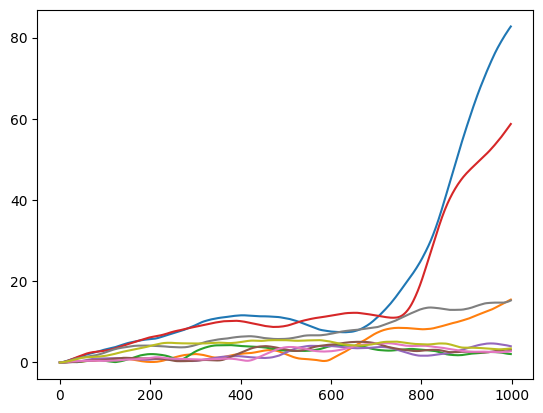

In [151]:
current_clustering = np.array(clustering_results[clustering_names.index('hdbscan, min_cluster:2, min_samples:2')])
qtraj_nosup = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=False, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_center = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_kabsch = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "kabsch", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_procrustes = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "procrustes", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist_adj = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=True,  return_raw=True)

for qt in qtraj_dist:
    plt.plot(qt)

In [152]:
current_clustering = np.array(clustering_results[clustering_names.index('ground truth')])

In [153]:
qtraj_nosup = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=False, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_center = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = None, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_kabsch = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "kabsch", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_procrustes = get_Q_for_clustering_positions(traj_array, current_clustering, None, use_max=True, center_positions=True, apply_superimposition = "procrustes", thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=False, reference_frame=0, return_raw=True)
qtraj_dist_adj = get_Q_for_clustering_extended(dist_matrices, current_clustering, None, use_max=True, thinning_factor=None, only_adjacent=True,  return_raw=True)



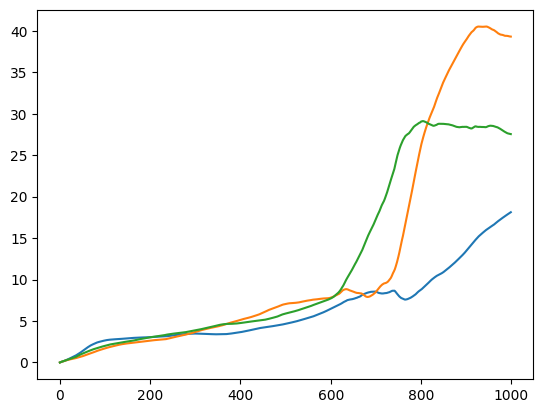

In [154]:
for qt in qtraj_nosup:
    plt.plot(qt)

Text(0.5, 1.0, 'RMSD from positions, centered, reference_frame=0')

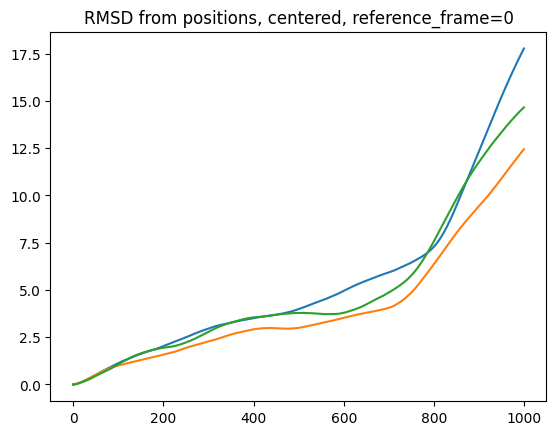

In [155]:
%matplotlib inline
for qt in qtraj_center:
    plt.plot(qt)
plt.title("RMSD from positions, centered, reference_frame=0")

Text(0.5, 1.0, 'RMSD from positions, Kabsch, reference_frame=0')

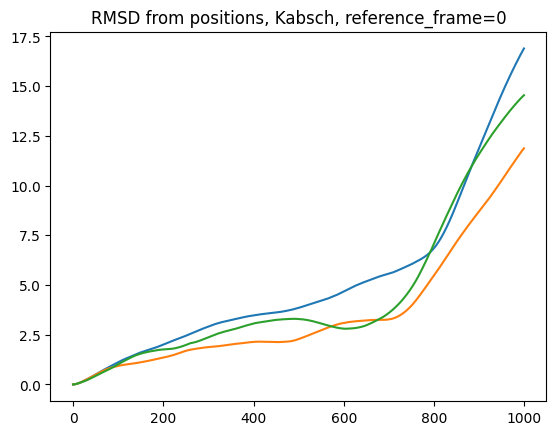

In [156]:
for qt in qtraj_kabsch:
    plt.plot(qt)
plt.title("RMSD from positions, Kabsch, reference_frame=0")

Text(0.5, 1.0, 'RMSD from positions, Procrustes, reference_frame=0')

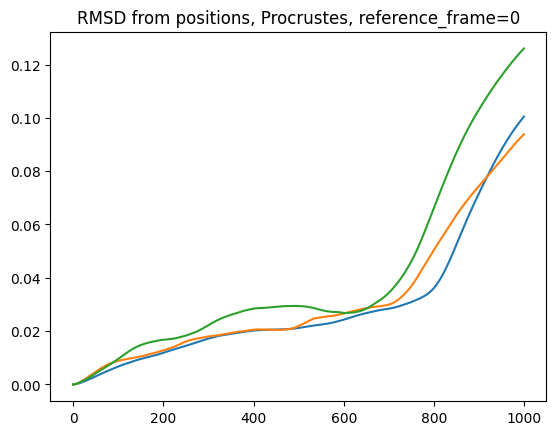

In [157]:
for qt in qtraj_procrustes:
    plt.plot(qt)
plt.title("RMSD from positions, Procrustes, reference_frame=0")

Text(0.5, 1.0, 'RMSD from distance matrices, reference_frame=0')

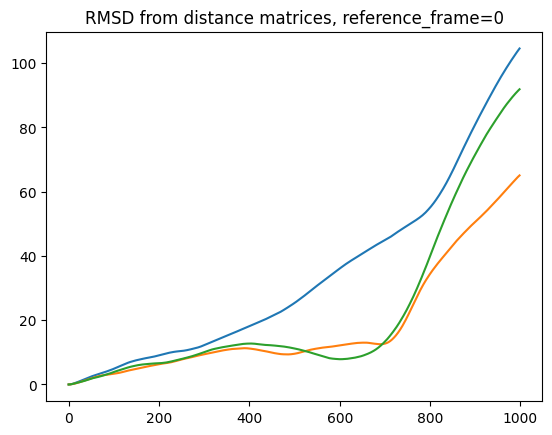

In [158]:
for qt in qtraj_dist:
    plt.plot(qt)
plt.title("RMSD from distance matrices, reference_frame=0")

Text(0.5, 1.0, 'RMSD from distance matrices, adjacent frames')

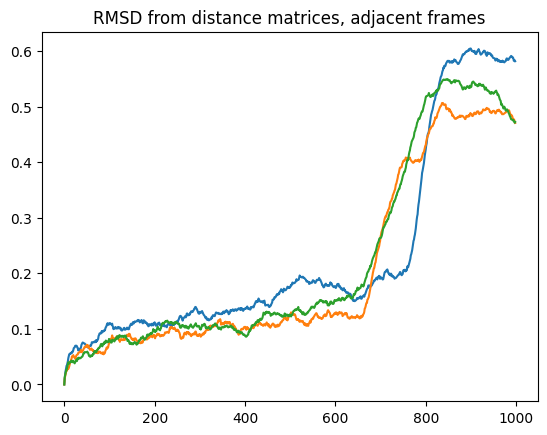

In [159]:
for qt in qtraj_dist_adj:
    plt.plot(qt)
plt.title("RMSD from distance matrices, adjacent frames")

In [160]:
clustering_results

[[13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  7,
  3,
  0,
  13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  7,
  3,
  0,
  13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  3,
  0,
  -1,
  14,
  14,
  14,
  14,
  14,
  14,
  14,
  14,
  14],
 [1,
  1,
  1,
  1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  1,
  1,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  -1,
  -1,
 

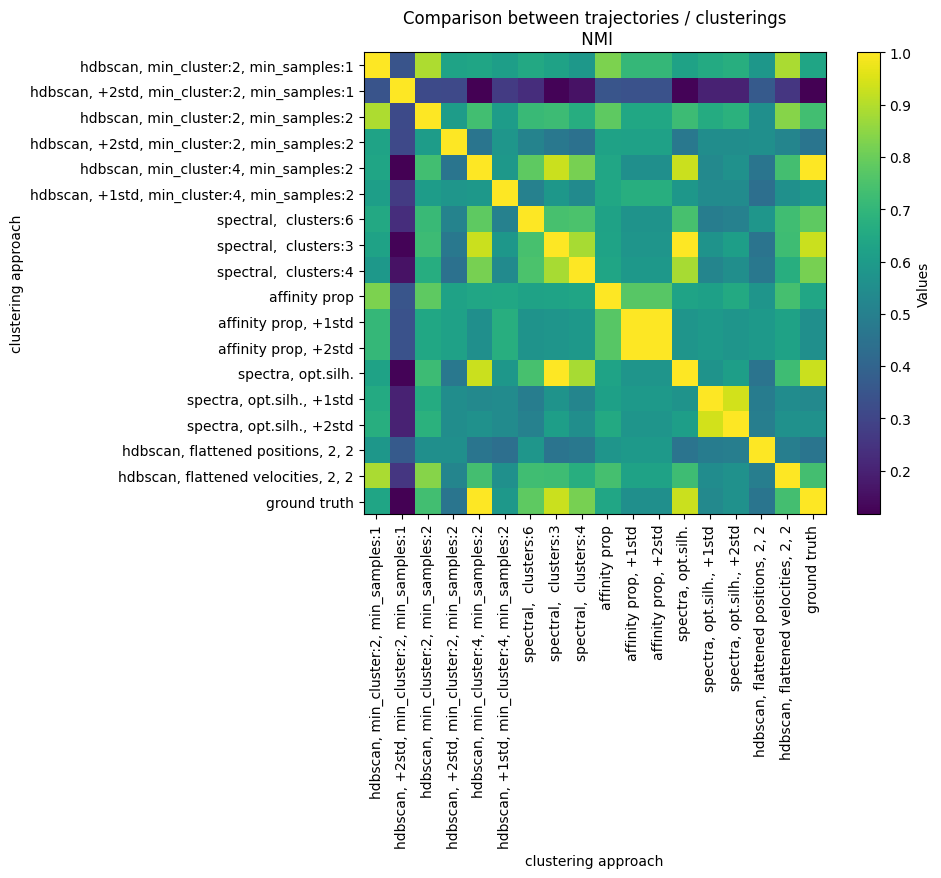

[[0, 0, 1.0],
 [0, 1, 0.3451062976115907],
 [0, 2, 0.8921533300027124],
 [0, 3, 0.62974517688411],
 [0, 4, 0.6344997560492759],
 [0, 5, 0.6104226979857335],
 [0, 6, 0.6494962029841471],
 [0, 7, 0.625212491597267],
 [0, 8, 0.5889558420424378],
 [0, 9, 0.8248595146179823],
 [0, 10, 0.7041671788680508],
 [0, 11, 0.7041671788680508],
 [0, 12, 0.625212491597267],
 [0, 13, 0.6553005457472025],
 [0, 14, 0.6707832800331965],
 [0, 15, 0.5839332577835447],
 [0, 16, 0.8870767424801774],
 [0, 17, 0.6344997560492759],
 [1, 0, 0.3451062976115907],
 [1, 1, 1.0],
 [1, 2, 0.31607682207585],
 [1, 3, 0.31293480626673836],
 [1, 4, 0.11672782268698174],
 [1, 5, 0.27110387195963676],
 [1, 6, 0.23353577514652635],
 [1, 7, 0.12484259493491179],
 [1, 8, 0.1593434385293255],
 [1, 9, 0.3494447738892427],
 [1, 10, 0.3379538210833798],
 [1, 11, 0.3379538210833798],
 [1, 12, 0.12484259493491179],
 [1, 13, 0.202533724936199],
 [1, 14, 0.20026925278877789],
 [1, 15, 0.36848226345356316],
 [1, 16, 0.2564449931691134],

In [161]:
%matplotlib inline
get_trajectory_heatmap(np.array(clustering_results), np.array(clustering_results), nmi = True, create_heatmap = True, title = "Comparison between trajectories / clusterings", names=clustering_names, heatmap_label="clustering approach")

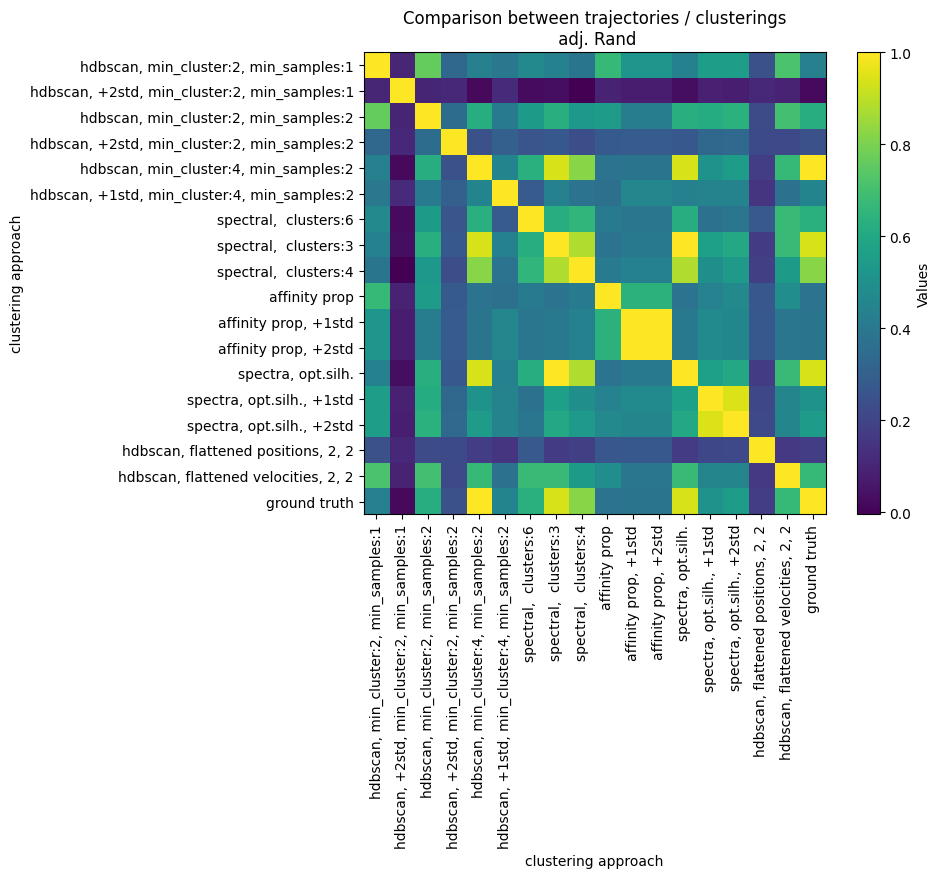

[[0, 0, 1.0],
 [0, 1, 0.10229573911058269],
 [0, 2, 0.7618744166344917],
 [0, 3, 0.3327120551413701],
 [0, 4, 0.43500180050414117],
 [0, 5, 0.39687248047290485],
 [0, 6, 0.4701018073091302],
 [0, 7, 0.4378106523694266],
 [0, 8, 0.38740173086928564],
 [0, 9, 0.6687872310567773],
 [0, 10, 0.5246759063317119],
 [0, 11, 0.5246759063317119],
 [0, 12, 0.4378106523694266],
 [0, 13, 0.5605572708576884],
 [0, 14, 0.5584169756265329],
 [0, 15, 0.2453383882045954],
 [0, 16, 0.7145814847678201],
 [0, 17, 0.43500180050414117],
 [1, 0, 0.10229573911058269],
 [1, 1, 1.0],
 [1, 2, 0.10025187617663998],
 [1, 3, 0.1114783325344165],
 [1, 4, 0.02100656455142232],
 [1, 5, 0.11706478556926524],
 [1, 6, 0.024257727271427467],
 [1, 7, 0.03345226172037926],
 [1, 8, -0.004155820184093877],
 [1, 9, 0.09073211638389314],
 [1, 10, 0.07749115474996544],
 [1, 11, 0.07749115474996544],
 [1, 12, 0.03345226172037926],
 [1, 13, 0.08680414591911978],
 [1, 14, 0.07904352454201746],
 [1, 15, 0.10765413246802825],
 [1, 16,

In [162]:
get_trajectory_heatmap(np.array(clustering_results), np.array(clustering_results), nmi = False, create_heatmap = True, title = "Comparison between trajectories / clusterings", names=clustering_names, heatmap_label="clustering approach")

In [163]:
clustering_results

[[13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  7,
  3,
  0,
  13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  7,
  3,
  0,
  13,
  13,
  13,
  13,
  13,
  13,
  8,
  4,
  10,
  1,
  11,
  11,
  11,
  11,
  11,
  11,
  12,
  9,
  5,
  2,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  3,
  0,
  -1,
  14,
  14,
  14,
  14,
  14,
  14,
  14,
  14,
  14],
 [1,
  1,
  1,
  1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  1,
  1,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  0,
  0,
  0,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  0,
  0,
  0,
  -1,
  -1,
 

In [164]:
clustering_names

['hdbscan, min_cluster:2, min_samples:1',
 'hdbscan, +2std, min_cluster:2, min_samples:1',
 'hdbscan, min_cluster:2, min_samples:2',
 'hdbscan, +2std, min_cluster:2, min_samples:2',
 'hdbscan, min_cluster:4, min_samples:2',
 'hdbscan, +1std, min_cluster:4, min_samples:2',
 'spectral,  clusters:6',
 'spectral,  clusters:3',
 'spectral,  clusters:4',
 'affinity prop',
 'affinity prop, +1std',
 'affinity prop, +2std',
 'spectra, opt.silh.',
 'spectra, opt.silh., +1std',
 'spectra, opt.silh., +2std',
 'hdbscan, flattened positions, 2, 2',
 'hdbscan, flattened velocities, 2, 2',
 'ground truth']

In [165]:

new_plot_data = process_data.prepare_clustered_results_for_plotly(trajectories, np.array(clustering_results[clustering_names.index('hdbscan, min_cluster:2, min_samples:2')]))

In [166]:
%matplotlib notebook

ab_hsv = plot_functions.plot_traj_labels_plt(new_plot_data, save_video=False, interval = 10, color_map='Spectral', noise_label = -1, title = "\n hdbscan, min_cluster:2, min_samples:2")

<IPython.core.display.Javascript object>

In [167]:
from IPython.display import HTML
HTML(ab_hsv.to_html5_video())